# <div style='text-align: center;'> **POYECTO FINAL** </div>
---

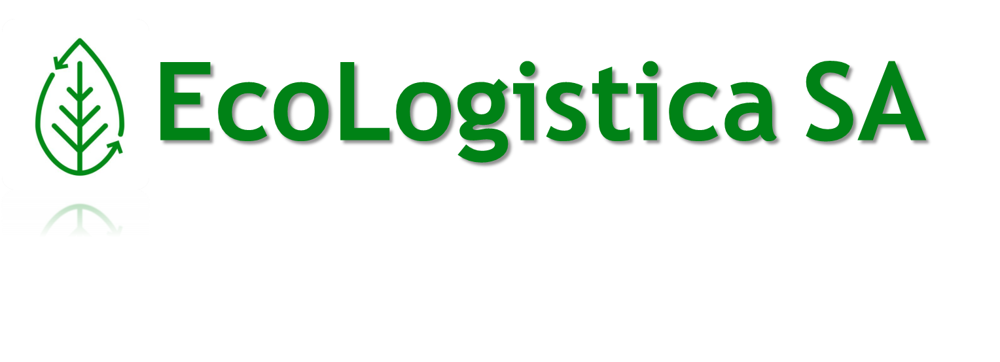

# **<u>INDICE</u>**

### **1. -  Introduccion**
---
### **2. -  Contexto y Problema Comercial**
  * *2.1  Objetivos y Preguntas de interes*  
  * *2.2  Audiencia*
---
### **3. -  Inspeccion de datos**
  * *3.1  Importacion de librerias*
    * Tratamiendo de datos
    * Configuracion de warnings
    * Graficos
    * Preporcesado y modelado
---
# **<u>Explorar y preparar los datos:</u>**
### **4. -  Data Acquisition**
---
### **5. -  Exploratory Data Analysis (Visualizando Distribuciones)**
---
### **6. -  Data Wrangling (Preprocesamiento y limpieza de datos)**
  * *6.1 Validacion del tipo de dato en la variable `'fecha_hora'`*
  * *6.2 Integración de datos: **`'df'`** y **`'df_tipo_de_cambio'`** para la creación de nuevas variables*
 * ***checkpoint***
  * *6.3 Analisis y limpieza de:*
    * Duplicados 
    * Nulos (Analisis y estimacion de dimensiones faltantes)
    * Outliers (Analisis, umbral de frontera y metricas)
  * ***checkpoint***
---
### **7. -  Feature Engineering (Ingeniería de *features*)** 
  * Definicion de *target* (objetivo)
  * LeabelEncoder
    
---
### **8. - Model Building and Training (Construcción y Entrenamiento del Modelo)**
  * *8.1 Seleccion del moedelo*
  * *8.2 División del conjunto de datos*
  * *8.3 Entrenamiento del modelo:*
    * 8.3.1 - LinearRegression
    * 8.3.2 - KNeighborsRegressor
    * 8.3.3 - RandomForestRegressor
    * 8.3.4 - XGBRegressor
    * 8.3.5 - Gradient Boosting Regressor
    * 8.3.6 - ElasticNet Regressor
    * 8.3.7 - LightGBM Regressor
    * 8.3.8 - CatBoost Regressor
  * *8.4 - Validación y ajuste de hiperparámetros:*
    * 8.4.1 -Definir la rejilla de hiperparámetros para cada modelo:
    * 8.4.2 - Preprocesamiento y creación del Pipeline:
    * 8.4.3 - Entrenar y ajustar hiperparámetros:
    * 8.4.4 - Resultados y comentarios:
  * *8.5 - Evaluación del modelo:*

### **9. - Conclusiones**


---
---


## ⏩ **1. <u>Introduccion</u>** 

La empresa nace en el año 1994 con el objetivo de desarrollar nuevas estrategias en el ámbito de las entregas puerta a puerta a nivel Nacional.
    A través de los años la empresa se va consolidando en el rubro, logrando un nombre de prestigio en el mercado.
    A lo largo de sus primeros 22 años de vida, ECOLOGISTICA no solo logra crecer en volumen y especialización, sino que también incorpora nuevos servicios, todos ellos de alto valor agregado.

## ⏩ **2. <u>Contexto y Problema Comercial</u>**

La empresa ECOLOGISTICA se dedica a ofrecer servicios de envío y logística a nivel nacional. En su operación diaria, la empresa realiza diferentes tipos de operaciones para sus clientes, desde el delivery de medicamentos como actividad principal y la distribucion de paqueteria liviana hasta 30 kg con medidas de hasta 260 cm en total, sumando alto, ancho y largo (El lado mayor no debe superar los 120 cm y su minimo no debe ser menor a 5 cm).

Uno de los problemas que la empresa enfrenta, es que el sector de Comerciales no cuenta con una matriz de costo para poder determinar el valor de venta de un PAQUETE de un punto a otro. Lo que incurre mucha veces en una mala venta y conflicto con el sector de Operaciones el cual se ve limitado a poder gestionar el servicio asi como el sector de Cobros y Pagos a proveedores. La empresa esta radicada en la CABA donde el codigo postal esta en los rangos de los 1400

Para abordar estos problemas, es necesario realizar un análisis exhaustivo de la información disponible por la empresa con el fin de evaluar las posibilidades de encontrar una solución y poder predecir el valor del paquete teniendo en cuenta sus caracteristicas. Además, es importante tener en cuenta un factor crucial que afectará la capacidad de alcanzar el objetivo: los valores están expresados en pesos argentinos, y debido a la constante devaluación e inflación de la moneda, será necesario convertir esos valores a dólares estadounidenses para realizar cálculos más confiables. Para lograr esto, utilizaremos un tipo de cambio oficial y así hacer que los datos sean más comprensibles y consistentes.

### 🔦 **2.1  <u>Objetivos y Preguntas de interes</u>**

**Objetivo**: Predecir el precio de los servicios, en especial el del **PACK** teniendo en cuenta las variables que caracterizan al mismo asi como datos geográficos, temporales y operativos.

**Preguntas**:

* **¿Qué variables se pueden usar para estimar el precio de los servicios?**
* **¿Qué modelo predictivo se puede aplicar para predecir el precio de los servicios?**
* **¿Qué nivel de precisión tiene el modelo predictivo?**
* **¿Qué ventajas tiene predecir el precio de los servicios para la gestión del negocio?**

### 🔦 **2.2 <u>Audiencia</u>**

* **La alta dirección de la empresa:** *informar los resultados del análisis y las recomendaciones para mejorar la rentabilidad y la satisfacción del cliente.*
* **El departamento de Comerciales:** *mejorar la eficiencia en el la venta de un servicio.*

## ⏩ **3. <u>Inspeccion de datos</u>**

### 🔦 **3.1 <u>Importacion de librerias:</u>**
#### <div style='text-align: left;'> Tratamiento de datos </div>
---

In [1]:
import numpy as np;
import pandas as pd;                 
import scipy as sp;
# Configurar pandas para que muestre toda la tabla sin truncar los datos
pd.options.display.max_rows = None
pd.options.display.max_columns = None
pd.set_option('display.max_columns', None);
pd.set_option('display.max_rows', None);
pd.set_option('display.width', None);
import locale;
import datetime as dt;
import missingno as msno;
from prettytable import PrettyTable;
locale.setlocale(locale.LC_TIME, 'es_ES.UTF-8');

#### <div style='text-align: left;'> Configuración warnings </div>
---

In [2]:
import warnings;
warnings.filterwarnings("ignore");

#### <div style='text-align: left;'> Graficos </div>
---

In [3]:
import matplotlib as mpl              # Importar MatPlotLib
import matplotlib.pyplot as plt       # El modulo Pyplot de Matplotlib
import matplotlib.ticker as ticker
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
import seaborn as sns                 # Importar Seaborn
from IPython.display import display,HTML;

# Cargar la hoja de estilos de Font Awesome
display(HTML('<link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/6.0.0-beta2/css/all.min.css">'))
from tabulate import tabulate;
import json

# ICONOS
icono_pen = '<i class="fa-solid fa-pen"></i>'
icono_save = '<i class="fa-regular fa-floppy-disk"></i>'
icono_note1 = '<i class="fa-regular fa-message-exclamation"></i>'
icono_note2 = '<i class="fa-regular fa-comment-exclamation"></i>'

#### <div style='text-align: left;'> Preprocesado y modelado </div>
---

In [4]:
import time
from scipy.optimize import minimize
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
import xgboost as xgb
from xgboost import XGBRegressor
import lightgbm as lgb
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import learning_curve

# <div style='text-align: left;'> **Explorar y preparar los datos** </div>
---

## ⏩ **4. <u>Data Acquisition</u>**

El primer paso es acceder a los datos. 
* Procederemos a cargar los data Set:

   * **1 - `df`** "contiene el set de datos a trabajar" (fuente: empresa de logistica)*

   * **2 - `df_tipo_de_cambio`** "contiene el historico del valor del dolar en argentina dia a dia" (fuente: 'https://datos.gob.ar/dataset/sspm-tipos-cambio-historicos/archivo/sspm_175.1')

In [5]:
ruta1='F:\\Proyecto\\Proyecto_Coder_DS\\set de datos\\df_proyecto_coder.csv'
ruta2='F:\\Proyecto\\Proyecto_Coder_DS\\set de datos\\tipo_cambio.csv'

df = pd.read_csv(ruta1, delimiter=',')
df_tipo_de_cambio = pd.read_csv(ruta2, delimiter=',')

## ⏩ **5. <u>Exploratory Data Analysis - Visualizando Distribuciones</u>** 

* Breve detalle de los datos

In [6]:
datasets = {'df': df, 'df_tipo_de_cambio': df_tipo_de_cambio}

for nombre, data in datasets.items():
    encabezado_1 = f'<h2>{icono_pen}  El {nombre.upper()} tiene: {data.shape[0]} filas y {data.shape[1]} columnas.</h2>'
    encabezado_2= f'<h2>{icono_pen}  El Tipos de datos de cada columna:</h2>'
    encabezado_3= f'<h2>{icono_pen}  Cantidad por Tipos de datos de cada columna:</h2>'
    encabezado_5= f'<h2>{icono_pen}  Descripcion de cada columna:</h2>'
    
    display(HTML(encabezado_1))
    display(data.head())
    
    # Crear un DataFrame con los tipos de datos
    df_dtypes = pd.DataFrame(data.dtypes)
    df_dtypes_count = pd.DataFrame(data.dtypes.value_counts())
    df_describe=pd.DataFrame(data.describe())

    # Definir la configuración de estilo
    styles = [
        {'selector': 'th', 'props': [('border', '1px solid black')]}
    ]

    # Aplicar el estilo a la tabla de tipos de datos
    styled_table = df_dtypes.style.set_table_styles(styles)
    styled_table_count = df_dtypes_count.style.set_table_styles(styles)
    styled_table_describe = df_describe.style.set_table_styles(styles)

    # Mostrar la tabla de tipos de datos con estilos HTML
    display(HTML(encabezado_2))
    display(HTML(styled_table.to_html()))
    display(HTML(encabezado_3))
    display(HTML(styled_table_count.to_html()))
    display(HTML(encabezado_5))
    display(HTML(styled_table_describe.to_html()))
    

,id,cliente_id,importe_urgente,bultos,peso,peso_volumetrico,ancho,alto,largo,tipo_operacion,comprador_cp,comprador_localidad,comprador_provincia,rem_cp,rem_localidad,rem_provincia,grupo,estado,fecha_hora,precio,costo_adicional1,costo_adicional2,costo_adicional3,costo_despacho_a_expreso,costo_distribuidor,costo_interno,costo_por_contrareembolso,costo_por_monitoreo_activo,costo_servicio_retorno,costo_transporte,servicio,cantidad,cliente_nombre,cp_destino,localidad_destino,zona_destino,subzona_destino,provincia_destino,cordon_destino,cp_origen,localidad_origen,zona_origen,subzona_origen,provincia_origen,cordon_origen
0,398567,454,0.0,1,3.0,0.0,0.0,0.0,0.0,ENTREGA PAQUETERIA,1611,DON TORCUATO,BUENOS AIRES,1000,DON TORCUATO,CAPITAL FEDERAL,DEVOLUCION,2DAV-2 VISITA SIN CONTACTO ALGUNO,2020-01-03 10:55:58,555.00,NaN,NaN,NaN,NaN,0.0,70.0,NaN,NaN,NaN,NaN,PACK,4503,SmartGenetics SRL,1611,DON TORCUATO,AMBA,GBA,BUENOS AIRES,3,1000,CAPITAL FEDERAL,AMBA,CABA,BUENOS AIRES,1
1,622855,454,0.0,1,3.0,0.0,0.0,0.0,0.0,ENTREGA PAQUETERIA,1611,DON TORCUATO,BUENOS AIRES,1000,CAPITAL FEDERAL,CAPITAL FEDERAL,ENTREGADA,POD-ENTREGADA,2020-05-28 10:41:32,656.29,NaN,NaN,NaN,NaN,0.0,70.0,NaN,NaN,NaN,NaN,PACK,4503,SmartGenetics SRL,1611,DON TORCUATO,AMBA,GBA,BUENOS AIRES,3,1000,CAPITAL FEDERAL,AMBA,CABA,BUENOS AIRES,1
2,1279434,454,NaN,1,3.0,0.0,0.0,0.0,0.0,ENTREGA PAQUETERIA,1611,DON TORCUATO,BUENOS AIRES,1000,CAPITAL FEDERAL,CAPITAL FEDERAL,ENTREGADA,POD-ENTREGADA,2021-02-03 07:45:51,856.67,NaN,NaN,NaN,NaN,0.0,70.0,NaN,NaN,NaN,NaN,PACK,4503,SmartGenetics SRL,1611,DON TORCUATO,AMBA,GBA,BUENOS AIRES,3,1000,CAPITAL FEDERAL,AMBA,CABA,BUENOS AIRES,1
3,1391674,454,NaN,1,3.0,0.0,0.0,0.0,0.0,ENTREGA PAQUETERIA,1611,DON TORCUATO,BUENOS AIRES,1000,CAPITAL FEDERAL,CAPITAL FEDERAL,ENTREGADA,POD-ENTREGADA,2021-03-30 09:09:27,856.67,NaN,NaN,NaN,NaN,0.0,70.0,NaN,NaN,NaN,NaN,PACK,4503,SmartGenetics SRL,1611,DON TORCUATO,AMBA,GBA,BUENOS AIRES,3,1000,CAPITAL FEDERAL,AMBA,CABA,BUENOS AIRES,1
4,1992496,454,NaN,1,3.0,0.0,0.0,0.0,0.0,ENTREGA PAQUETERIA,1611,DON TORCUATO,BUENOS AIRES,1000,CAPITAL FEDERAL,CAPITAL FEDERAL,ENTREGADA,POD-ENTREGADA,2021-10-19 14:59:14,1166.81,NaN,NaN,NaN,NaN,0.0,130.0,NaN,NaN,NaN,NaN,PACK,4503,SmartGenetics SRL,1611,DON TORCUATO,AMBA,GBA,BUENOS AIRES,3,1000,CAPITAL FEDERAL,AMBA,CABA,BUENOS AIRES,1


,0
id,int64
cliente_id,int64
importe_urgente,float64
bultos,int64
peso,float64
peso_volumetrico,float64
ancho,float64
alto,float64
largo,float64
tipo_operacion,object


,0
object,18
float64,17
int64,10


,id,cliente_id,importe_urgente,bultos,peso,peso_volumetrico,ancho,alto,largo,comprador_cp,rem_cp,precio,costo_adicional1,costo_adicional2,costo_adicional3,costo_despacho_a_expreso,costo_distribuidor,costo_interno,costo_por_contrareembolso,costo_por_monitoreo_activo,costo_servicio_retorno,costo_transporte,cantidad,cp_destino,cordon_destino,cp_origen,cordon_origen
count,2142431.000000,2142431.000000,86751.000000,2142431.000000,2112577.000000,2139951.000000,1929580.000000,1929580.000000,1929580.000000,2142431.000000,2142431.000000,2139366.000000,8193.000000,0.000000,0.000000,0.000000,902373.000000,1660014.000000,51311.000000,0.000000,45619.000000,200751.000000,2142431.000000,2142431.000000,2142431.000000,2142431.000000,2142431.000000
mean,1723209.994903,176.484756,20.899783,1.290976,4.561969,0.659749,1.368299,1.112897,1.482868,1935.471864,1431.932366,661.192369,786.080557,nan,nan,nan,76.093166,181.814352,0.000000,nan,0.000000,407.355451,385415.256224,1935.471864,2.253493,1431.932366,1.564956
std,774200.058741,255.063828,506.534414,9.997094,1367.258166,17.115826,11.272968,10.821452,12.287497,1360.960662,670.895494,4627.820059,2669.722306,nan,nan,nan,396.184822,779.706423,0.000000,nan,0.000000,2422.045732,217766.390197,1360.960662,1.912894,670.895494,1.182512
min,345959.000000,3.000000,0.000000,-4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1000.000000,1000.000000,0.000000,0.000000,nan,nan,nan,0.000000,-520.000000,0.000000,nan,0.000000,0.000000,1.000000,1000.000000,0.000000,1000.000000,0.000000
25%,964204.500000,8.000000,0.000000,1.000000,0.500000,0.000000,0.000000,0.000000,0.000000,1416.000000,1199.000000,186.890000,350.000000,nan,nan,nan,0.000000,70.000000,0.000000,nan,0.000000,20.010000,112836.000000,1416.000000,1.000000,1199.000000,1.000000
50%,1815501.000000,14.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1617.000000,1199.000000,312.120000,428.000000,nan,nan,nan,0.000000,143.500000,0.000000,nan,0.000000,70.510000,496382.000000,1617.000000,2.000000,1199.000000,1.000000
75%,2402396.500000,311.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1800.000000,1603.000000,523.630000,750.000000,nan,nan,nan,0.000000,193.000000,0.000000,nan,0.000000,230.340000,536048.000000,1800.000000,3.000000,1603.000000,2.000000
max,3112387.000000,903.000000,93884.030000,11928.000000,1869182.000000,5940.000000,1800.000000,1980.000000,3020.000000,9431.000000,9420.000000,1108048.000000,180008.000000,nan,nan,nan,180008.000000,361000.000000,0.000000,nan,0.000000,615448.610000,537584.000000,9431.000000,12.000000,9420.000000,12.000000


,indice_tiempo,tipo_cambio_bna_vendedor,tipo_cambio_a3500,tipo_cambio_mae,volumen_mae,tipo_cambio_implicito_en_adrs,futuro_rofex_usd1m,interes_abierto_1m,futuro_rofex_usd2m,interes_abierto_2m,futuro_rofex_usd3m,interes_abierto_3m,futuro_rofex_usd4m,interes_abierto_4m,futuro_rofex_usd5m,interes_abierto_5m,futuro_rofex_usd6m,interes_abierto_6m
0,2002-03-05,NaN,1.9917,NaN,NaN,2.180124,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2002-03-06,NaN,2.0508,NaN,NaN,2.222222,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2002-03-07,NaN,2.1375,NaN,NaN,2.343949,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2002-03-08,NaN,2.2033,NaN,NaN,2.227778,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2002-03-09,NaN,2.2033,NaN,NaN,2.227778,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,0
indice_tiempo,object
tipo_cambio_bna_vendedor,float64
tipo_cambio_a3500,float64
tipo_cambio_mae,float64
volumen_mae,float64
tipo_cambio_implicito_en_adrs,float64
futuro_rofex_usd1m,float64
interes_abierto_1m,float64
futuro_rofex_usd2m,float64
interes_abierto_2m,float64


,0
float64,17
object,1


,tipo_cambio_bna_vendedor,tipo_cambio_a3500,tipo_cambio_mae,volumen_mae,tipo_cambio_implicito_en_adrs,futuro_rofex_usd1m,interes_abierto_1m,futuro_rofex_usd2m,interes_abierto_2m,futuro_rofex_usd3m,interes_abierto_3m,futuro_rofex_usd4m,interes_abierto_4m,futuro_rofex_usd5m,interes_abierto_5m,futuro_rofex_usd6m,interes_abierto_6m
count,3071.000000,7697.000000,5386.000000,3334.000000,7695.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000,5201.000000
mean,57.117318,24.279867,33.376031,218193.626275,39.245150,35.086795,965643.802923,36.732015,657744.085945,38.490721,449948.565853,40.258433,327323.365314,42.044124,248576.193617,43.859094,195291.490867
std,50.048679,39.228102,43.854820,140288.460434,75.984097,45.344029,797051.311135,48.235144,467887.250436,51.392344,366216.106676,54.584873,322014.863868,57.866224,256603.307899,61.270928,250616.918795
min,8.490000,1.991700,3.012000,500.000000,2.180124,3.470000,13.000000,3.510000,287.000000,3.550000,20022.000000,3.590000,32796.000000,3.630000,29000.000000,3.670000,8305.000000
25%,15.600000,3.149700,4.353250,120100.000000,3.177965,4.580000,427687.000000,4.660000,368619.000000,4.730000,271370.000000,4.800000,178780.000000,4.880000,119755.000000,4.970000,81397.000000
50%,39.000000,4.668500,9.627500,181175.000000,6.595331,14.040000,641643.000000,14.400000,527850.000000,14.720000,353686.000000,15.020000,248150.000000,15.290000,181490.000000,15.610000,127007.000000
75%,94.125000,18.010800,45.000000,284055.000000,17.897093,57.770000,1183801.000000,62.380000,782417.000000,64.890000,505490.000000,67.300000,364375.000000,69.600000,280416.000000,71.800000,236176.000000
max,215.500000,208.988300,209.010000,1546850.000000,404.620623,210.100000,4438237.000000,225.600000,4416601.000000,246.250000,3430609.000000,265.650000,3436969.000000,286.800000,2763188.000000,312.500000,2766503.000000


Segun lo observado podemos determinar quee las respuesta a la pegunta *`¿Qué variables se pueden usar para estimar el precio de los servicios?`*

Las variables mas relevantes para estimar el precio del servicio son:
* **'`id`'** : "Clave unica que identifica la guia de operación" 
* **'`fecha_hora`'** : "fecha de creacion de la guia de operación"
* **'`servicio`'** : "tipo de servicio contratado"
* **'`peso`'** : "peso en kg de envio"
* **'`peso_volumetrico`'** : "el espacio ocupado por un paquete en función de sus dimensiones físicas (Alto x Ancho x Largo) / Factor de conversión"
* **'`bultos`'** : "muestra la cantidad bultos que conforman la guia de operación"
* **'`alto`', '`largo`', '`ancho`'** : "medidas del paquete o servicio"
* **'`precio`'** : "precio de venta del servicio contratado en la guia de operación" *`variable target`*
* **'`cp_destino`'** : "variable que contiene codigo postal destino"
* **'`provincia_destino`'** : "variable que contiene la provincia destino"
* **'`subzona_destino`'** :"variable que contiene a que region corresponde el destino **('CABA' 'GBA' 'CENTRO' 'NOA' 'NEA' 'CUYO' 'PATAGONIA')**" 
* **'`cp_origen`'** : "variable que contiene codigo postal origen
* **'`provincia_origen`'** : "variable que contiene la provincia origen"
* **'`subzona_origen`'** :"variable que contiene a que region corresponde el origen **('CABA' 'GBA' 'CENTRO' 'NOA' 'NEA' 'CUYO' 'PATAGONIA')**" 
* ***'`aquellas relacionadas con COSTOS`*** las cuales son 10: "Son las variables que indican el costo que tiene un servicio dado". *Mas adelante unificaremos estos valores en una nueva y unica variable*

Las variables que seleccionaremos de **`df_tipo_de_cambio`** son:
* **'`indice_tiempo`'** : "fecha del dato"
* **'`tipo_cambio_bna_vendedor`'** : "valor del tipo de cambio"

---

* Ahora veremos los distintos servicios que presenta la Empresa

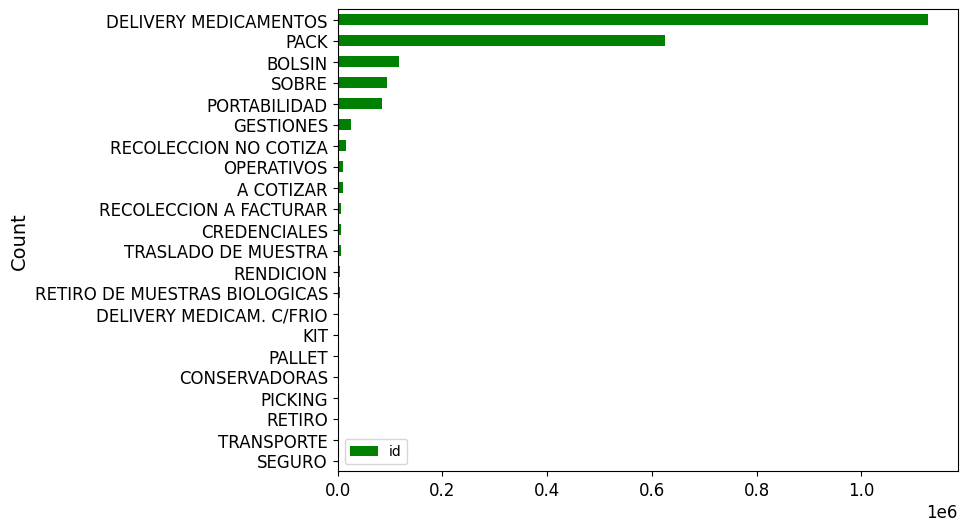

In [7]:
df_grouped = df.groupby('servicio')['id'].count().reset_index()
df_grouped_sorted = df_grouped.sort_values('id')
df_grouped_sorted.plot(figsize=(8, 6), kind='barh', x='servicio', y='id', color='green', ylabel='Count', legend='Envios')
plt.show()


Como podemos ver, el **`PACK`** es el 2do servicio más frecuente que tiene la empresa y es el que le sigue al DELIVERY DE MEDICAMENTOS.

- Para tener un objeto más uniforme de estudio, solo utilizaremos el servicio **`"PACK"`** que es el servicio del cual debemos predecir el **`precio`**, para ello 
crearemos un nuevo set con este filtro.

In [8]:
df_eda = df[df['servicio'] == 'PACK'].copy()

* por una cuestion de visualizacion y tener un analisis bien prolijo, crearemos una variable llamada **'`total_costo`'** para agurupar la suma de las 10 variables de costo.

In [9]:
columnas_costos = [
'costo_adicional1',
'costo_adicional2',
'costo_adicional3',
'costo_despacho_a_expreso',
'costo_distribuidor',
'costo_interno',
'costo_por_contrareembolso',
'costo_por_monitoreo_activo',
'costo_servicio_retorno',
'costo_transporte',]

In [10]:
# Paso 1: Calcular la suma de las columnas de costos y asignar el resultado a una nueva columna
df_eda['total_costo'] = df_eda[columnas_costos].sum(axis=1)
# Paso 2: Eliminar las columnas de costos del conjunto de datos
df_eda.drop(columnas_costos, axis=1, inplace=True)

Se crea una nueva variable:
 
 * **'`total_costo`'** : "costo operativo de la guia de operaciones"

 ---



 * Seleccionaremos las variables relevantes y crearemos un nuevo set llamado `df_filtrado` a fin de describrir y visualizar los datos de forma tal que nos de intuicion sobre ellos y ver si hay o no la necesidad de agregar mas datos.

In [11]:
columnas_1 = ['id','fecha_hora', 'servicio', 'peso', 'peso_volumetrico', 'bultos', 'alto', 'largo', 'ancho', 'precio', 'total_costo', 'cp_destino', 'cp_origen',
            'provincia_origen','provincia_destino','subzona_origen','subzona_destino']

In [12]:
df_filtro = df_eda[columnas_1].copy()
df_filtro["fecha_hora"] = pd.to_datetime(df_filtro["fecha_hora"]).dt.date
df_filtro.head()

,id,fecha_hora,servicio,peso,peso_volumetrico,bultos,alto,largo,ancho,precio,total_costo,cp_destino,cp_origen,provincia_origen,provincia_destino,subzona_origen,subzona_destino
0,398567,2020-01-03,PACK,3.0,0.0,1,0.0,0.0,0.0,555.00,70.0,1611,1000,BUENOS AIRES,BUENOS AIRES,CABA,GBA
1,622855,2020-05-28,PACK,3.0,0.0,1,0.0,0.0,0.0,656.29,70.0,1611,1000,BUENOS AIRES,BUENOS AIRES,CABA,GBA
2,1279434,2021-02-03,PACK,3.0,0.0,1,0.0,0.0,0.0,856.67,70.0,1611,1000,BUENOS AIRES,BUENOS AIRES,CABA,GBA
3,1391674,2021-03-30,PACK,3.0,0.0,1,0.0,0.0,0.0,856.67,70.0,1611,1000,BUENOS AIRES,BUENOS AIRES,CABA,GBA
4,1992496,2021-10-19,PACK,3.0,0.0,1,0.0,0.0,0.0,1166.81,130.0,1611,1000,BUENOS AIRES,BUENOS AIRES,CABA,GBA


* Generaremos una matriz de correlacion para observar la relacion que tienen estas variables seleccionadas y ver que efecto generan sobre el **'precio'**

Tiempo de ejecución: 7.60476279258728 segundos


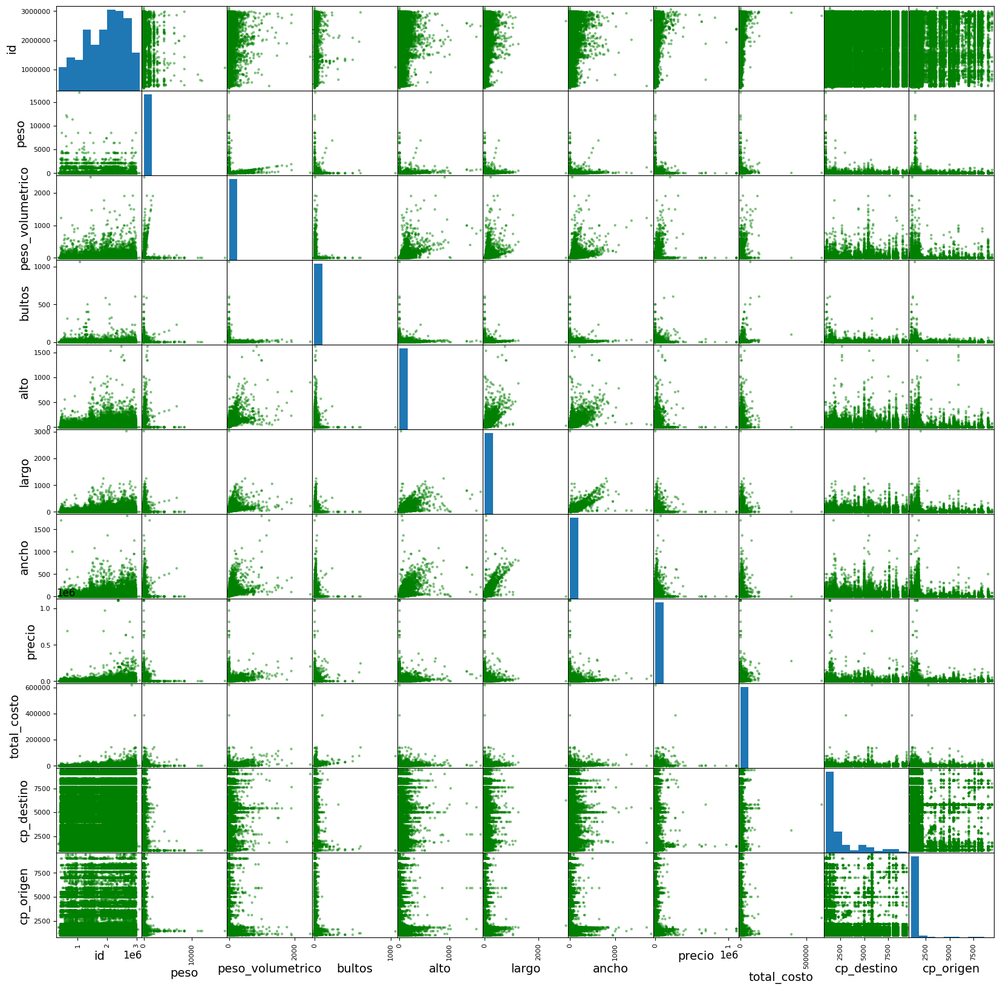

In [13]:
start_time = time.time()
_ = pd.plotting.scatter_matrix(df_filtro, figsize=(20, 20),color='green')
end_time = time.time()
execution_time = end_time - start_time
print("Tiempo de ejecución:", execution_time, "segundos")

In [14]:
display(df_filtro.corr(numeric_only=True).precio.sort_values().to_frame())

,precio
cp_origen,0.049640
id,0.068462
peso,0.071506
cp_destino,0.083215
ancho,0.162031
largo,0.165343
bultos,0.176364
alto,0.210110
peso_volumetrico,0.285173
total_costo,0.300240


A primera vista podemos observar algunos **`outliers`** adicionales en la variables **'`peso, peso_volumetrico, precio, alto, ancho, largo`'** que nos genera un ruido extra. Recordemos que el servicio del paquete es hasta 30 kg en la variable **`'peso'`**, con medidas hasta 150 cm en total, sumando **`alto, ancho y largo`** (El lado mayor no debe superar los 90 cm y su minimo a 10 cm). Por lo tanto, teniendo en cuenta esto podemos intuir que hay paquetes que estan mal clasificados ya que superan estos parametros.

...

Detalles extras:

* Al observar la variable **'`precio`'** con el **'`id`'** el cual este ultimo esta ordenado en secuencia segun la fecha, notamos una tendencia al aumento.
* Al observar las variables **'`cp_origen`', '`cp_destino`'** podemos distinguir que el mayor caudal de envios de **`PACK`** se da entre los codigos postales del 0 al 2500 estos estan compuestos por parte de la provincia de `Buenos Aires, Santa Fe`.
* Otra observacion, es que, se pueden ver muchos valore cercanos a cero en las variables **'`peso`', '`alto`', '`ancho`' y '`largo`'** esos nos indica que pueden existir nulos o valores cero los cuales validaremos y ajustaremos.

Podemos ver una Correlacion debil positiva con del **'`precio`'** del **`PACK`**. Lo que indica una leve tendencia de aumento en el **'`precio`'** cuando estas variables aumentan. Esto sugiere una relación lineal leve.

...

* Analicemos la relacion del **'`precio`', '`total_costo`', '`peso`', '`peso_volumetrico`', '`bultos`','`envios`', '`alto`', '`ancho`', '`largo`'** a lo largo del tiempo para ver si encontramos alguna observacion y podemos intuir algun comportamiento. 

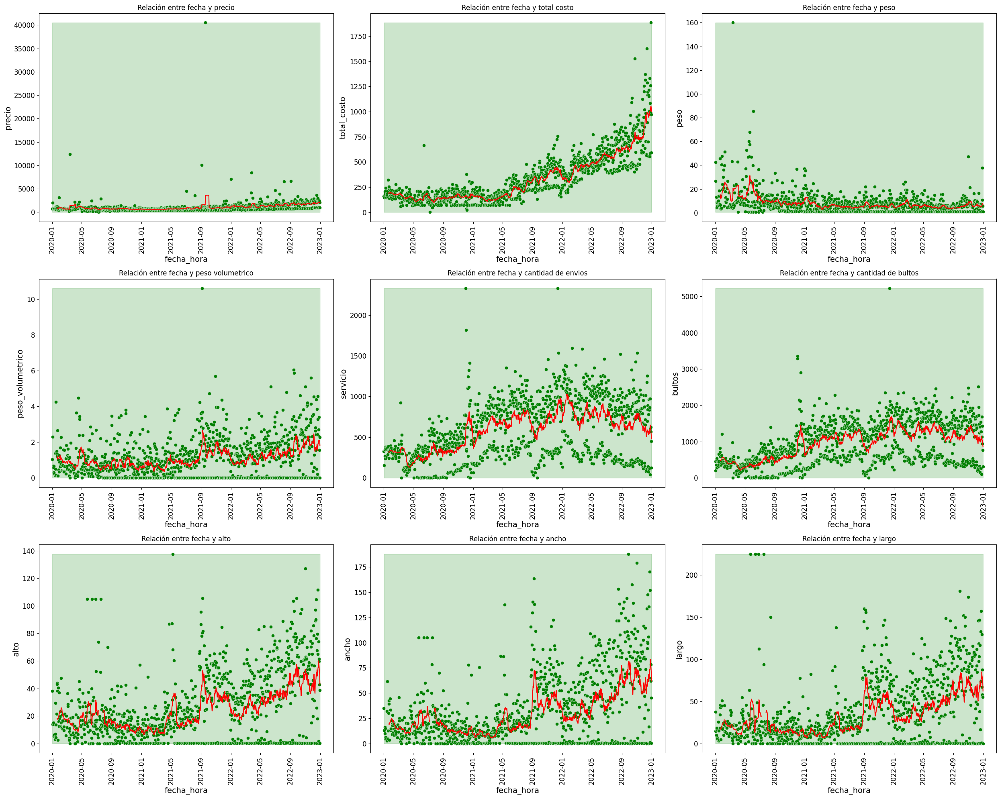

In [15]:
columnas_2 = ['precio','total_costo', 'peso', 'peso_volumetrico','servicio','bultos','alto', 'ancho', 'largo']
titulos = ['Relación entre fecha y precio','Relación entre fecha y total costo', 'Relación entre fecha y peso', 'Relación entre fecha y peso volumetrico','Relación entre fecha y cantidad de envios','Relación entre fecha y cantidad de bultos','Relación entre fecha y alto','Relación entre fecha y ancho','Relación entre fecha y largo']

df_grouped = df_filtro.groupby(['fecha_hora']).agg({
    'precio':'mean',
    'total_costo':'mean',
    'peso':'mean',
    'peso_volumetrico':'mean',
    'servicio':'count',
    'bultos':'sum',
    'alto':lambda x: x.mean() * 10,
    'ancho':lambda x: x.mean() * 10,
    'largo':lambda x: x.mean() * 10
}).reset_index()

df_grouped["fecha_hora"] = pd.to_datetime(df_grouped["fecha_hora"]).dt.date

fig, axs = plt.subplots(3, 3, figsize=(25, 20))
axs = axs.flatten()

for i, (columna, titulo) in enumerate(zip(columnas_2, titulos)):
    ax = axs[i]
    sns.scatterplot(data=df_grouped, x='fecha_hora', y=columna, color='green', ax=ax)
    ax.fill_between(df_grouped['fecha_hora'], df_grouped[columna].min(), df_grouped[columna].max(), alpha=0.2, color='green')
    ax.plot(df_grouped['fecha_hora'], df_grouped[columna].rolling(window=15, min_periods=15).mean(), color='red', linestyle='-', label='Promedio móvil')
    ax.set_title(titulo)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    formatter = ticker.FuncFormatter(lambda x, pos: f'{x:.0f}')
    ax.yaxis.set_major_formatter(formatter)
    #ax.set_yscale('log')

plt.tight_layout()
plt.show()

Al observar los 9 gráficos, podemos notar ciertas tendencias a lo largo del tiempo:
* El gráfico del `precio` presenta dificultades para distinguir claramente la tendencia debido a la presencia de un `**outlier**` de gran escala. Sin embargo, considerando la alta correlación entre el `precio` y el costo según la matriz de correlación, podemos inferir que el `precio` ha experimentado un aumento gradual a lo largo del tiempo, al igual que el costo total. No obstante, no se observa la misma tendencia en las variables de `bultos` y cantidad de envíos. Este comportamiento sugiere que las variaciones en el `precio` y el costo a lo largo del tiempo pueden estar influenciadas por factores relacionados con la moneda local en la que se estima el servicio. Dado que la empresa opera en Argentina y utiliza el peso argentino como moneda, es posible que las fluctuaciones en el `precio` estén asociadas a las devaluaciones y a la pérdida de poder adquisitivo del peso. Para realizar un análisis más preciso, se recomienda realizar una conversión a una moneda más estable, como el dólar estadounidense, con el fin de obtener una perspectiva más sólida de los cambios en el `precio` a lo largo del tiempo y así lograr el objetivo del análisis, que es predecir el `precio` del PACK.

* Los gráficos de las variables `alto, ancho y largo` indican un aumento en el tamaño de los paquetes a medida que pasa el tiempo. Sin embargo, también se observa que muchos envíos no cuentan con información registrada para estas variables. Esta falta de datos se hace evidente al visualizar los gráficos con una escala logarítmica en el eje y, donde se puede apreciar claramente que el valor cero está presente. Esto tambien influye de forma negativa sobre la variable `peso_volumetrico` ya que esta depende de las 3 mensionadas. Dado que el porcentaje de valores cero es relativamente bajo, pero podría tener un impacto significativo en nuestro proyecto, es recomendable tratar estos valores para obtener estimaciones más precisas de los patrones relacionados con el tamaño de los paquetes.

## ⏩ **6. <u>Data Wrangling - preprocesamiento y limpieza de datos</u>**

En esta sección, llevaremos a cabo una serie de transformaciones en los datos con el objetivo de realizar un análisis exhaustivo:

* Combinación de los datos del DataFrame principal **`df`** (renombrado como **`df_eda`**) con los datos del DataFrame `df_tipo_de_cambio`. Esta combinación nos permitirá obtener la cotización del dólar en la fecha correspondiente, lo cual será útil para representar las variables "`precio`" y "`total_costo`" en moneda extranjera (dólares). Asimismo, crearemos nuevas variables, como "'`margen_ganancia`'", tanto en pesos argentinos como en dólares. Durante este proceso, también verificaremos la presencia de valores atípicos (outliers) en la variable "`precio`" y en todas las variables relacionadas con nuestro objetivo. En caso de detectarlos, evaluaremos la necesidad de eliminarlos o modificarlos. Los resultados obtenidos se almacenarán en un nuevo conjunto de datos denominado **`df_3`**.

* Para mejorar la calidad y utilidad de los datos en nuestro proyecto, realizaremos la conversión de la variable "`fecha_hora`" al formato `.date` y crearemos nuevas variables. Esto nos permitirá realizar un análisis temporal más detallado y obtener una visión completa de los patrones y tendencias en los datos.

* Por último, llevaremos a cabo una descripción detallada de las variables creadas y seleccionadas. Además, analizaremos los valores nulos para determinar su impacto en el proyecto. Este análisis nos permitirá identificar posibles problemas o sesgos en los datos, así como también nos dará una idea de qué variables son más importantes para nuestro análisis y cómo podemos utilizarlas de manera efectiva.

Con estas transformaciones y análisis, estaremos preparando los datos de manera adecuada para llevar a cabo un análisis riguroso y obtener información valiosa que nos permita alcanzar los objetivos de nuestro proyecto.

#### 🔦 **6.1** Validacion del tipo de dato en la variable "fecha_hora"**
---

In [16]:
display(df_eda["fecha_hora"].head(2).to_frame().rename(columns={0: 'fecha_hora2'}))
print(df_eda["fecha_hora"].dtype)
display(df_tipo_de_cambio["indice_tiempo"].head(2).to_frame().rename(columns={0: 'indice_tiempo'}))
print(df_tipo_de_cambio["indice_tiempo"].dtype)

,fecha_hora
0,2020-01-03 10:55:58
1,2020-05-28 10:41:32


object


,indice_tiempo
0,2002-03-05
1,2002-03-06


object


Podemos ver que el formato del tipo fecha de los dataset que devemos cruzar son incompatibles, si bien son ***object*** y el formato de ambos son en **yy-mm-dd**, el ***df*** tiene **hh-mm-ss**. Por tal motivo, se creara una copia del **"`fecha_hora`"** la cual contenga solo los **yy-mm-dd**

In [17]:
df_eda["fecha_hora"] = pd.to_datetime(df_eda["fecha_hora"], format="%Y-%m-%d  %H:%M:%S")
df_eda["fecha_hora2"] = df_eda["fecha_hora"].dt.date #creamos otra variable de fecha pero sin la h-m-s
df_eda["fecha_hora2"] = pd.to_datetime(df_eda["fecha_hora2"], format="%Y-%m-%d")
df_tipo_de_cambio["indice_tiempo"] = pd.to_datetime(df_tipo_de_cambio["indice_tiempo"], format="%Y-%m-%d")

Verifico que el cambio se haya realizado bien

In [18]:
display(df_eda["fecha_hora"].head(2).to_frame().rename(columns={0: 'fecha_hora'}))
print(df_eda["fecha_hora"].dtype)
display(df_eda["fecha_hora2"].head(2).to_frame().rename(columns={0: 'fecha_hora2'}))
print(df_eda["fecha_hora2"].dtype)
display(df_tipo_de_cambio["indice_tiempo"].head(2).to_frame().rename(columns={0: 'indice_tiempo'}))
print(df_tipo_de_cambio["indice_tiempo"].dtype)

,fecha_hora
0,2020-01-03 10:55:58
1,2020-05-28 10:41:32


datetime64[ns]


,fecha_hora2
0,2020-01-03
1,2020-05-28


datetime64[ns]


,indice_tiempo
0,2002-03-05
1,2002-03-06


datetime64[ns]


#### 🔦 **6.2** Integración de datos: **`'df'`** y **`'df_tipo_de_cambio'`** para la creación de nuevas variables
---

* Unimos los DataFrames según la columna **'`fecha2`'** y **'`indice_tiempo`'**

    De esta union nace la variable:

    * **'`tipo_cambio_bna_vendedor`'** : "cotizacion del dolar en la fecha"

con esta variable podremos ralizar las siguientes trasformaciones y creaciones.

In [19]:
df_1 = pd.merge(df_eda, df_tipo_de_cambio, left_on='fecha_hora2', right_on='indice_tiempo')

* Creamos variables: 

    * **'`precio_USD`'** : "precio de venta equivalente en dolares segun Banco Nacion Argentino"
    * **'`total_costo_USD`'** : "costo operativo de la guia de operaciones en USD"
    * **'`margen_ganancia`'** : "diferencia entre el precio y el costo"
    * **'`margen_ganancia_USD`'** : "diferencia entre el precio en USD y el costo USD"

In [20]:
df_1['total_costo_USD']=df_1['total_costo']/df_1['tipo_cambio_bna_vendedor']
df_1['precio_USD']=df_1['precio']/df_1['tipo_cambio_bna_vendedor']
df_1['precio'] = df_1['precio'].fillna(0)
df_1['margen_ganancia'] = df_1['precio'] - df_1['total_costo']
df_1['margen_ganancia_USD'] = df_1['precio_USD'] - df_1['total_costo_USD']

* Creamos otra nueva variable:
    * **'`movimiento`'** : "clasifica las guias de operación tomando en cuenta el origen y destino segun lo indica la Empresa, **(AMBA-INTERIOR, INTERIOR-INTERIOR, INTERIOR-AMBA)**"
        * **`AMBA`**: "Codigo postal del `1000` al `1999`, abarco lo que es el conubano de la provincia de Bs As"

        ![Descripción de la imagen](https://www.argentina.gob.ar/sites/default/files/mapa_amba.jpg)

        * **`INTERIOR`**: "Codigo postal del `2000` al `9000`, abarca todo el pais que no sea **`AMBA`**

In [21]:
def movimiento(row):
    if row['cp_origen'] < 2000 and row['cp_destino'] < 2000:
        return 'AMBA-AMBA'
    elif row['cp_origen'] < 2000 and row['cp_destino'] >= 2000:
        return 'AMBA-INTERIOR'
    elif row['cp_origen'] >= 2000 and row['cp_destino'] < 2000:
        return 'INTERIOR-AMBA'
    else:
        return 'INTERIOR-INTERIOR'

# Crear nueva columna "movimiento"
df_1['movimiento'] = df_1.apply(movimiento, axis=1)

 Finalizada la etapa de creacion de variables realizamos un **`checkpoint`** relacionado con el Servicio `PACK`.

In [22]:
columnas_seleccionadas=['id', 'fecha_hora', 'servicio',           
       'peso', 'peso_volumetrico', 'bultos',
       'alto', 'largo', 'ancho', 
       'precio', 'precio_USD', 
       'total_costo','total_costo_USD',  
       'cp_destino', 'provincia_destino', 'subzona_destino', 
       'cp_origen', 'provincia_origen', 'subzona_origen', 'movimiento']

In [25]:
df_1[df_1['servicio'] == 'PACK'][columnas_seleccionadas].to_csv('df_2.csv', index=False)

In [26]:
df_2 = pd.read_csv('df_2.csv', delimiter=',')

#### 🔦 **6.3** Analisis y limpieza de Duplicados / Nulos / Outliers
---

##### ♦  **DUPLICADOS**

Validaremos la existencia de los mismos usando como referencia la variable **`'id'`** en la cual se alojan las claves unicas que identifica la guia de operación.

In [27]:
# Validar si hay duplicados
duplicados = df_2[df_2.duplicated(subset='id')]

if duplicados.shape[0] > 0:
    print(f'Hay {duplicados.shape[0]} filas duplicadas en el DataFrame')
else:
    print('No hay filas duplicadas en el DataFrame')

# Eliminar duplicados
df_2.drop_duplicates(subset='id', inplace=True)
print(f'\nLuego de la eliminación de duplicados, el dataset tiene {df_2.shape[0]} filas y {df_2.shape[1]} columnas.')


No hay filas duplicadas en el DataFrame

Luego de la eliminación de duplicados, el dataset tiene 624408 filas y 20 columnas.


##### **♦ NULOS**

In [28]:
serie_nulos = df_2.isnull().sum()
serie_nulos_sorted = serie_nulos.sort_values(ascending=False)
display(serie_nulos_sorted.head(10).to_frame().rename(columns={0: 'Cantidad de Nulos'}))

,Cantidad de Nulos
alto,43359
largo,43359
ancho,43359
precio_USD,2698
peso,1177
peso_volumetrico,109
cp_destino,0
subzona_origen,0
provincia_origen,0
cp_origen,0


* Analizar el porcentaje que representan los valores nulos en el total de datos

In [29]:
porcentaje_perdidos = df_2.isnull().sum() * 100 / len(df_2)
valores_perdidos = pd.DataFrame({'Porcentaje_Missing': porcentaje_perdidos})
valores_perdidos.sort_values(by='Porcentaje_Missing', ascending=False, inplace=True)
display(valores_perdidos.head(10).rename_axis('Columna').reset_index().rename(columns={'Porcentaje_Missing': 'Porcentaje de Valores Nulos'}))


,Columna,Porcentaje de Valores Nulos
0,alto,6.944017
1,largo,6.944017
2,ancho,6.944017
3,precio_USD,0.432089
4,peso,0.188499
5,peso_volumetrico,0.017457
6,cp_destino,0.000000
7,subzona_origen,0.000000
8,provincia_origen,0.000000
9,cp_origen,0.000000


* Graficamos el % de nulos

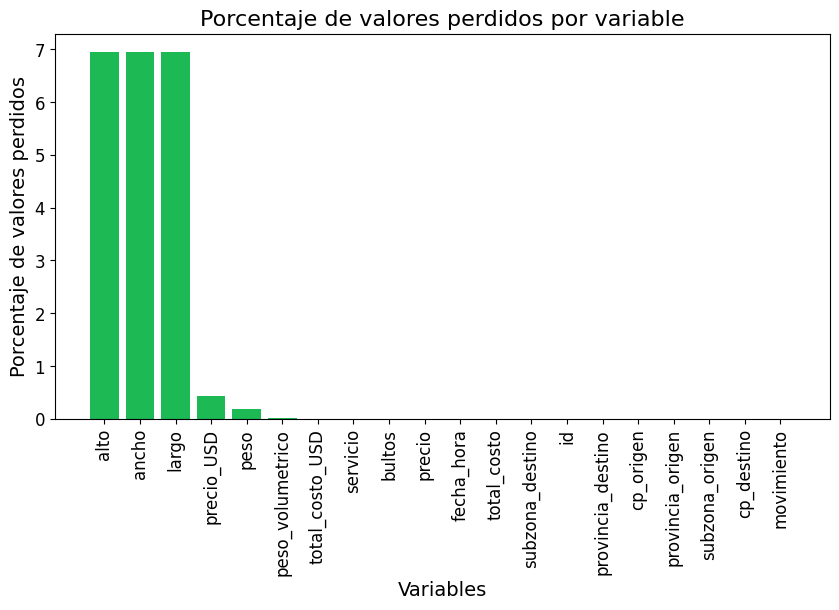

In [30]:
fig, ax = plt.subplots(figsize=(10, 5))
valores_perdidos_sorted = valores_perdidos.sort_values(by='Porcentaje_Missing', ascending=False)
ax.bar(valores_perdidos_sorted.index, valores_perdidos_sorted['Porcentaje_Missing'], color='#1DB954')
ax.set_xlabel('Variables')
ax.set_ylabel('Porcentaje de valores perdidos')
ax.set_title('Porcentaje de valores perdidos por variable', fontsize=16)
plt.xticks(rotation=90, fontsize=12)
plt.yticks(fontsize=12)
plt.show()

⭕ Después de analizar el porcentaje de valores faltantes en cada variable del DataFrame, se observó que las variables `alto, ancho, largo` presentan el mayor porcentaje de valores faltantes, con un total de `6.94%` de valores nulos, mientras que la variable `'peso'` tiene un `0.18%` y `'peso_volumetrico'` casi nada de valores faltantes. Estas variables son de especial importancia para nuestro análisis, ya que estamos enfocados en predecir el precio del producto `PACK`.

Dado que estas variables son clave para lograr una mayor precisión en nuestras predicciones, hemos decidido aplicar técnicas de optimización para estimar los valores faltantes en estas dimensiones y asi rellenarlos. Esto nos permitirá tener una base de datos más completa y precisa para nuestro análisis.

* Analicemos cantidad de ceros en las columnas `peso y peso_volumetrico` para poder decidir que pasos se seguiran.

In [31]:
zeros_count1 = (df_2['peso'] == 0).sum()
non_zeros_count1 = (df_2['peso'] != 0).sum()
zeros_count2 = (df_2['peso_volumetrico'] == 0).sum()
non_zeros_count2 = (df_2['peso_volumetrico'] != 0).sum()

print("Cantidad de valores cero en la columna 'peso':", zeros_count1)
print("Cantidad de valores cero en la columna 'peso_volumetrico':", zeros_count2)
print("---")
print("Cantidad de valores diferentes de cero en la columna 'peso':", non_zeros_count1)
print("Cantidad de valores diferentes de cero en la columna 'peso_volumetrico':", non_zeros_count2)

Cantidad de valores cero en la columna 'peso': 245
Cantidad de valores cero en la columna 'peso_volumetrico': 398402
---
Cantidad de valores diferentes de cero en la columna 'peso': 624163
Cantidad de valores diferentes de cero en la columna 'peso_volumetrico': 226006


In [32]:
zeros_count3 = (df_2['ancho'] == 0).sum()
zeros_count4 = (df_2['alto'] == 0).sum()
zeros_count5 = (df_2['largo'] == 0).sum()
non_zeros_count3 = (df_2['ancho'] != 0).sum()
non_zeros_count4 = (df_2['alto'] != 0).sum()
non_zeros_count5 = (df_2['largo'] != 0).sum()

print("Cantidad de valores cero en la columna 'ancho':", zeros_count3)
print("Cantidad de valores cero en la columna 'alto':", zeros_count4)
print("Cantidad de valores cero en la columna 'largo':", zeros_count5)
print("---")
print("Cantidad de valores diferentes de cero en la columna 'ancho':", non_zeros_count3)
print("Cantidad de valores diferentes de cero en la columna 'alto':", non_zeros_count4)
print("Cantidad de valores diferentes de cero en la columna 'largo':", non_zeros_count5)

Cantidad de valores cero en la columna 'ancho': 248961
Cantidad de valores cero en la columna 'alto': 248576
Cantidad de valores cero en la columna 'largo': 248896
---
Cantidad de valores diferentes de cero en la columna 'ancho': 375447
Cantidad de valores diferentes de cero en la columna 'alto': 375832
Cantidad de valores diferentes de cero en la columna 'largo': 375512


Podemos observar que hay una discrepancia en la cantidad de valores diferentes de cero en las variables de dimensiones (`alto, ancho, largo`) y la cantidad de valores diferentes de cero en la variable de `peso_volumetrico`. Esto puede indicar una falta de valores de peso volumétrico calculados correctamente o una discrepancia en los datos registrados.

Específicamente, mientras que las variables de dimensiones (`alto, ancho, largo`) tienen una cantidad considerablemente alta de valores diferentes de cero, la variable de `peso_volumetrico` tiene una cantidad mucho menor de valores diferentes de cero. Puede que haya habido errores en el proceso de asignación de peso volumétrico a los registros por error humano o de sistema.

Por lo tanto realizaremos los siguientes procesos:

* Reemplazar valores nulos y ceros en las variables `'peso'', 'peso_volumetrico'` por el `.mean` de cada uno.
* Remplazar los valores nulos y ceros en las variables `'alto', 'ancho', 'largo'` a travez de una estimacion de dimensiones a partir del `'peso_volumetrico'` 



In [33]:
df_2_describe=pd.DataFrame(df_2[['peso', 'peso_volumetrico']].describe())
styled_df_2_describe=df_2_describe.style.set_table_styles(styles)
display(HTML(styled_df_2_describe.render()))

,peso,peso_volumetrico
count,623231.000000,624299.000000
mean,7.967702,1.426438
std,91.959647,17.077902
min,0.000000,0.000000
25%,1.000000,0.000000
50%,1.000000,0.000000
75%,2.560000,0.000000
max,16992.000000,2475.000000


In [34]:
df_2['peso'].fillna(df_2['peso'].mean(), inplace=True)
df_2['peso_volumetrico'].fillna(df_2['peso_volumetrico'].mean(), inplace=True)

df_2['peso'].replace(0, df_2['peso'].mean(), inplace=True)
df_2['peso_volumetrico'].replace(0, df_2['peso_volumetrico'].mean(), inplace=True)

* Reemplazar valores nulos en las columnas `"alto", "ancho", "largo"` y otras por cero

In [35]:
columnas_a_reemplazar = ['alto', 'ancho', 'largo', 'precio_USD', 'peso_volumetrico'] 
df_2[columnas_a_reemplazar] = df_2[columnas_a_reemplazar].fillna(0)

* Analizamos nuevamente si quedaron `NULOS`

In [36]:
serie_nulos = df_2.isnull().sum()
serie_nulos_sorted = serie_nulos.sort_values(ascending=False)
display(serie_nulos_sorted.head(20).to_frame().rename(columns={0: 'Cantidad de Nulos'}))

,Cantidad de Nulos
id,0
fecha_hora,0
subzona_origen,0
provincia_origen,0
cp_origen,0
subzona_destino,0
provincia_destino,0
cp_destino,0
total_costo_USD,0
total_costo,0


* Estimación de Dimensiones Faltantes mediante Optimización:

Este proceso utiliza técnicas de optimización para estimar las dimensiones faltantes del conjunto de datos que tiene valores de ancho, alto y largo igual a cero. La misma se realiza utilizando una funcion personalizada llamada `estimar_dimensiones_vacias`. El objetivo es encontrar las dimensiones óptimas que minimicen la diferencia entre el producto de `ancho, alto y largo` y el peso promedio de las filas no nulas. El aforo utlidizado para realizar esto es `/ 4000`

In [37]:
def estimar_dimensiones_vacias(df_2):
    # Filtrar las filas con ancho, alto y largo igual a 0
    filas_sin_dimensiones = df_2[(df_2['ancho'] == 0) & (df_2['alto'] == 0) & (df_2['largo'] == 0)]

    # Calcular el peso promedio de las filas no nulas
    peso_promedio = df_2[df_2['peso_volumetrico'].notnull()]['peso_volumetrico'].mean()

    def objetivo(dimensions):
        ancho, alto, largo = dimensions
        return abs(ancho * alto * largo / 4000 - peso_promedio)

    for index, row in filas_sin_dimensiones.iterrows():
        # Inicializar las dimensiones para la optimización
        x0 = np.array([1, 1, 1])  # Valores iniciales

        # Definir las restricciones para las dimensiones (mayores que 0)
        restricciones = [{'type': 'ineq', 'fun': lambda x: x[0]},  # ancho > 0
                         {'type': 'ineq', 'fun': lambda x: x[1]},  # alto > 0
                         {'type': 'ineq', 'fun': lambda x: x[2]}]  # largo > 0

        # Resolver la optimización
        resultado = minimize(objetivo, x0, constraints=restricciones)
        ancho_opt, alto_opt, largo_opt = resultado.x

        # Actualizar los valores en el DataFrame
        df_2.at[index, 'ancho'] = ancho_opt
        df_2.at[index, 'alto'] = alto_opt
        df_2.at[index, 'largo'] = largo_opt

    return df_2

# Llamar a la función estimar_dimensiones_vacias
df_2_up = estimar_dimensiones_vacias(df_2)

**`checkpoint`**

In [38]:
df_2_up.to_csv('df_2_actualizado.csv', index=False)

##### ♦ **OUTLIERS**

In [39]:
df_2_actualizado = pd.read_csv('df_2_actualizado.csv', delimiter=',')


Durante la exploración de los datos, hemos identificado la presencia de outliers en las variables `'peso', 'precio_USD', 'total_costo_USD', 'alto', 'ancho' y 'largo'`. Estos outliers pueden generar ruido adicional en nuestro análisis. Con el fin de abordar esta situación, considerando que el servicio de paquetería admite paquetes de hasta 30 kg y medidas totales de hasta 150 cm (sumando el alto, ancho y largo), hemos decidido realizar los siguientes pasos:

* Aplicar filtros adecuados para cumplir con las medidas establecidas.
* Crear una lista de percentiles que nos permitirá evaluar umbrales de frontera basados en la variable `'precio_USD'`. Utilizaremos:
    * Calcular la cantidad de outliers utilizando un umbral.
    * Calcular la media y la mediana de la variable objetivo.
    * Calcular la desviación estándar y el rango intercuartil (IQR) de la variable objetivo.
     
Esto nos ayudará a determinar el filtro adecuado para esta variable en particular, ya que durante nuestro análisis exploratorio de datos hemos detectado posibles falsos positivos en la clasificación de los servicios del tipo **`'PACK'`**.

Mediante la implementación de estos pasos, esperamos mejorar la calidad de nuestros datos.

In [40]:
df_filtro_2 = df_2_actualizado[
    (df_2_actualizado['peso'] <= 30) &
    (df_2_actualizado['alto'] + df_2_actualizado['ancho'] + df_2_actualizado['largo'] <= 150) &
    (df_2_actualizado[['alto', 'ancho', 'largo']].max(axis=1) <= 90) &
    (df_2_actualizado['alto'] > 10) &
    (df_2_actualizado['ancho'] > 10) &
    (df_2_actualizado['largo'] > 10)
].copy()

In [41]:
# Calcular la cantidad de outliers utilizando un umbral
umbral_superior = np.percentile(df_filtro_2['precio_USD'], 95)
umbral_inferior = np.percentile(df_filtro_2['precio_USD'], 5)
cantidad_outliers = ((df_filtro_2['precio_USD'] > umbral_superior) | (df_filtro_2['precio_USD'] < umbral_inferior)).sum()

In [42]:
# Calcular la media y la mediana de la variable objetivo
media_precio = df_filtro_2['precio_USD'].mean()
mediana_precio = df_filtro_2['precio_USD'].median()

In [43]:
# Calcular la desviación estándar y el rango intercuartil (IQR) de la variable objetivo
desviacion_estandar_precio = df_filtro_2['precio_USD'].std()
iqr_precio = df_filtro_2['precio_USD'].quantile(0.75) - df_filtro_2['precio_USD'].quantile(0.25)

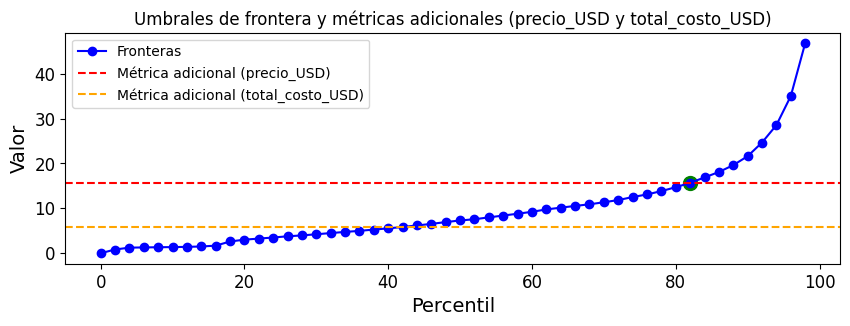

Umbrales de frontera en los puntos de cruce: [82]


,frontera,total_costo_frontera
0,0.000000,0.000000
2,0.823529,0.915033
4,1.244019,1.183309
6,1.289028,1.253012
8,1.332901,1.268293
10,1.365217,1.293082
12,1.418262,1.309554
14,1.501946,1.341121
16,1.686893,1.356974
18,2.612792,1.366667


,frontera,total_costo_frontera
80,14.708702,8.288484
82,15.677618,8.814062
84,16.885984,9.252976
86,18.098225,9.802436
88,19.623518,10.507097
90,21.622597,11.395211
92,24.665588,12.675114
94,28.547970,14.564828
96,35.017499,17.561293
98,46.788060,23.537905


In [44]:
percentiles = range(0, 100, 2)  # Lista de percentiles a evaluar

fronteras = {}

for percentile in percentiles:
    umbral = np.percentile(df_filtro_2[['precio_USD', 'total_costo_USD']], percentile)
    fronteras[percentile] = umbral

# Calcular la métrica adicional (por ejemplo, utilizar la media o la cantidad de outliers)
media_precio = df_filtro_2['precio_USD'].mean()
media_total_costo = df_filtro_2['total_costo_USD'].mean()


plt.figure(figsize=(10, 3))
plt.plot(list(fronteras.keys()), list(fronteras.values()), marker='o', linestyle='-', color='blue', label='Fronteras')
plt.axhline(media_precio, linestyle='--', color='red', label='Métrica adicional (precio_USD)')  # Agregar la línea de la métrica adicional
plt.axhline(media_total_costo, linestyle='--', color='orange', label='Métrica adicional (total_costo_USD)')

plt.xlabel('Percentil')
plt.ylabel('Valor')
plt.title('Umbrales de frontera y métricas adicionales (precio_USD y total_costo_USD)')
plt.legend()


# Encontrar el punto de cruce entre las dos líneas
indice_cruce = np.where(np.diff(np.sign(list(fronteras.values()) - media_precio)))[0]

# Obtener los umbrales de frontera correspondientes a los índices de cruce
umbrales_cruce = [list(fronteras.keys())[indice] for indice in indice_cruce]

# Marcar los puntos de cruce en el gráfico
plt.scatter(umbrales_cruce, [media_precio] * len(umbrales_cruce), marker='o', s=100, color='green', label='Puntos de cruce')


plt.show()
print("Umbrales de frontera en los puntos de cruce:", umbrales_cruce)

# Convertir el diccionario 'fronteras' en un DataFrame
df_fronteras = pd.DataFrame.from_dict(fronteras, orient='index', columns=['frontera'])
df_fronteras['total_costo_frontera'] = np.percentile(df_filtro_2['total_costo_USD'], list(fronteras.keys()))
ultimos_valores = df_fronteras[['frontera', 'total_costo_frontera']].tail(10)
primeros_valores = df_fronteras[['frontera', 'total_costo_frontera']].head(10)
display(primeros_valores)
display(ultimos_valores)


En base a una evaluación manual y los resultados obtenidos, se encontró que tanto el percentil `82` como el percentil `92` podrían ser adecuados para determinar los umbrales de frontera. Por tal motivo seleccionaremos el resultado obtenido en el percentil `92` el cual utilizaremos para filtrar el valor del `'precio_USD' y 'total_costo_USD'`

In [45]:
df_filtro_2a = df_filtro_2[(df_filtro_2['total_costo_USD'] <= 12.67) & (df_filtro_2['precio_USD'] <= 24.66) & 
                           (df_filtro_2['total_costo_USD'] > 1) & (df_filtro_2['precio_USD'] > 1)].copy()


In [46]:
df_filtro_2a.shape

(23191, 20)

In [47]:
def detectar_outliers(columna):
    q1 = columna.quantile(0.25)
    q2 = columna.median()
    q3 = columna.quantile(0.75)
    iqr = q3 - q1
    umbral = 1.5    
    outliers = (columna < q1 - umbral * iqr) | (columna > q3 + umbral * iqr)
    return outliers

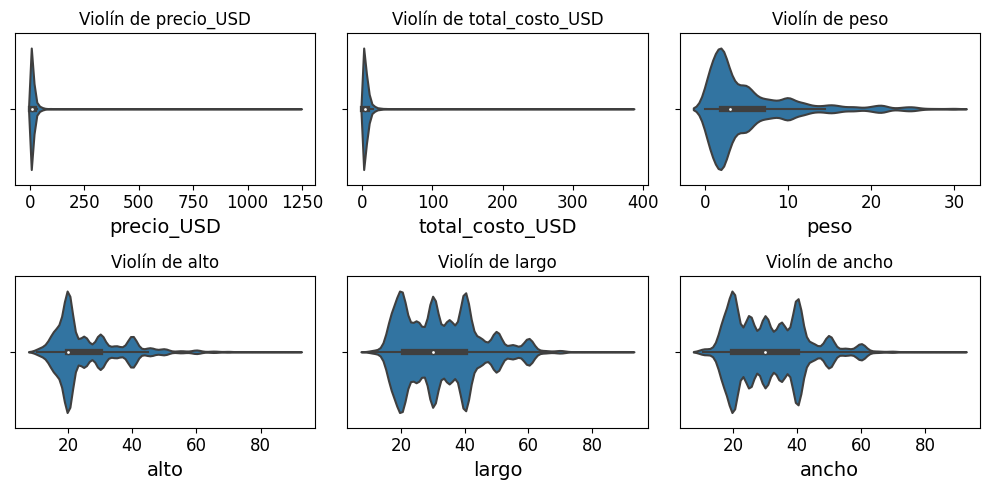

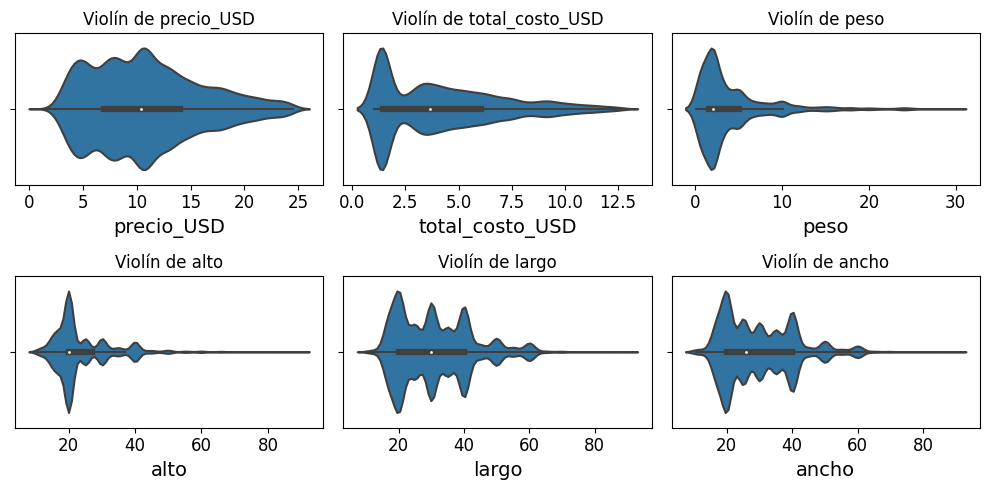

In [48]:
display(HTML(f'<h2>{icono_pen}  ANTES:</h2>'))

fig, axes = plt.subplots(2, 3, figsize=(10, 5), tight_layout=True)

columnas = ['precio_USD', 'total_costo_USD', 'peso', 'alto', 'largo', 'ancho']

for i, columna in enumerate(columnas):
    outliers = detectar_outliers(df_filtro_2[columna])
    sns.violinplot(x=df_filtro_2[columna], ax=axes[i // 3, i % 3], showfliers=~outliers)
    axes[i // 3, i % 3].set_title(f'Violín de {columna}')

plt.subplots_adjust(hspace=0.5)
plt.show()

display(HTML(f'<h2>{icono_pen}  DESPUES:</h2>'))

fig, axes = plt.subplots(2, 3, figsize=(10, 5), tight_layout=True)

columnas = ['precio_USD', 'total_costo_USD', 'peso', 'alto', 'largo', 'ancho']

for i, columna in enumerate(columnas):
    outliers = detectar_outliers(df_filtro_2a[columna])
    sns.violinplot(x=df_filtro_2a[columna], ax=axes[i // 3, i % 3], showfliers=~outliers)
    axes[i // 3, i % 3].set_title(f'Violín de {columna}')

plt.subplots_adjust(hspace=0.5)
plt.show()

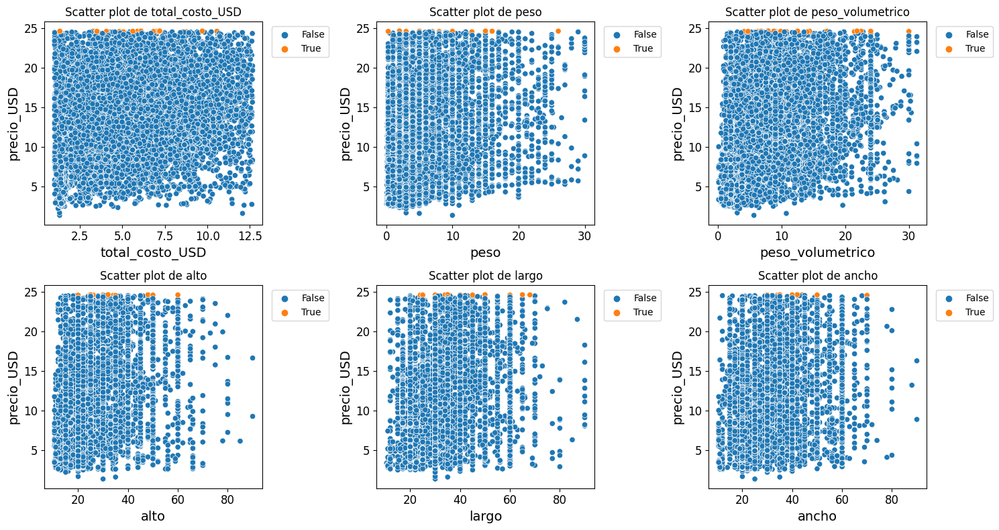

In [49]:
fig, axes = plt.subplots(2, 3, figsize=(15, 8), tight_layout=True)

variables = ['total_costo_USD', 'peso', 'peso_volumetrico', 'alto', 'largo', 'ancho']

for i, variable in enumerate(variables):
    outliers = detectar_outliers(df_filtro_2a['precio_USD'])
    sns.scatterplot(data=df_filtro_2a, x=variable, y='precio_USD', ax=axes[i // 3, i % 3], hue=outliers)
    axes[i // 3, i % 3].set_title(f'Scatter plot de {variable}')
    axes[i // 3, i % 3].legend(bbox_to_anchor=(1.02, 1), loc='upper left')

plt.subplots_adjust(hspace=0.5)
plt.show()

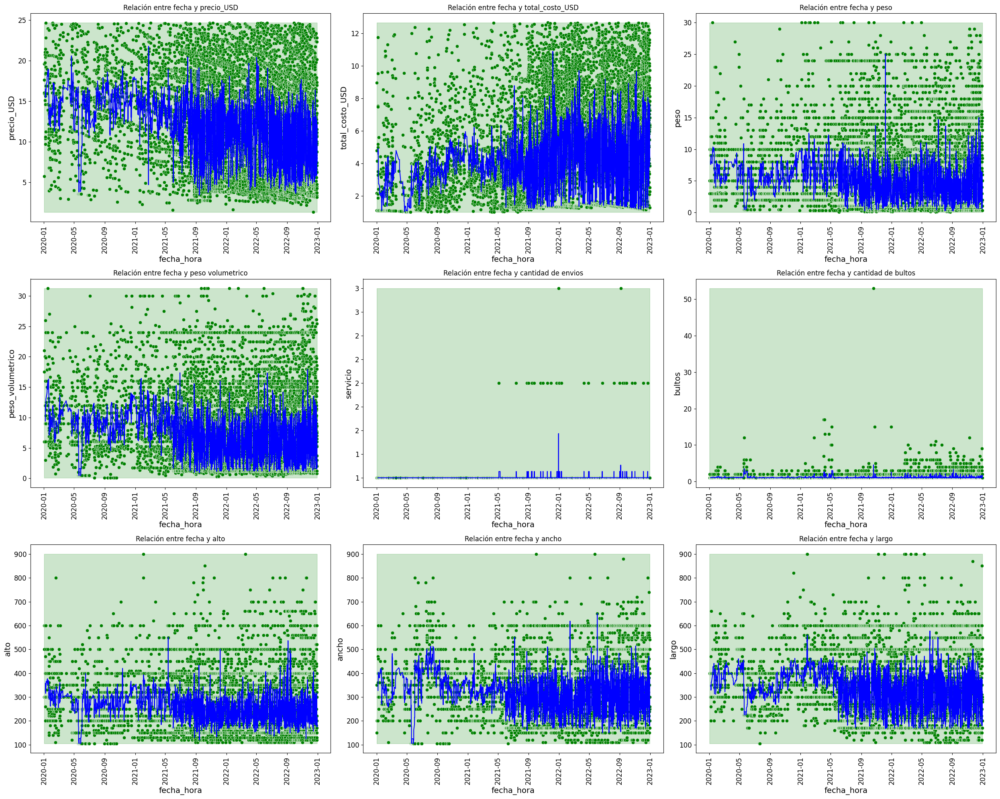

In [50]:
columnas_2 = ['precio_USD','total_costo_USD', 'peso', 'peso_volumetrico','servicio','bultos','alto', 'ancho', 'largo']
titulos = ['Relación entre fecha y precio_USD','Relación entre fecha y total_costo_USD', 'Relación entre fecha y peso', 'Relación entre fecha y peso volumetrico','Relación entre fecha y cantidad de envios','Relación entre fecha y cantidad de bultos','Relación entre fecha y alto','Relación entre fecha y ancho','Relación entre fecha y largo']

df_grouped2 = df_filtro_2a.groupby(['fecha_hora']).agg({
    'precio_USD':'mean',
    'total_costo_USD':'mean',
    'peso':'mean',
    'peso_volumetrico':'mean',
    'servicio':'count',
    'bultos':'sum',
    'alto':lambda x: x.mean() * 10,
    'ancho':lambda x: x.mean() * 10,
    'largo':lambda x: x.mean() * 10
}).reset_index()

df_grouped2["fecha_hora"] = pd.to_datetime(df_grouped2["fecha_hora"]).dt.date

fig, axs = plt.subplots(3, 3, figsize=(25, 20))
axs = axs.flatten()

for i, (columna, titulo) in enumerate(zip(columnas_2, titulos)):
    ax = axs[i]
    sns.scatterplot(data=df_grouped2, x='fecha_hora', y=columna, color='green', ax=ax)
    ax.fill_between(df_grouped2['fecha_hora'], df_grouped2[columna].min(), df_grouped2[columna].max(), alpha=0.2, color='green')
    ax.plot(df_grouped2['fecha_hora'], df_grouped2[columna].rolling(window=15, min_periods=15).mean(), color='blue', linestyle='-', label='Promedio móvil')
    ax.set_title(titulo)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    formatter = ticker.FuncFormatter(lambda x, pos: f'{x:.0f}')
    ax.yaxis.set_major_formatter(formatter)
    #ax.set_yscale('log')

plt.tight_layout()
plt.show()

Ahora si, como podemos observar ya no hay mas nulos. Veamos nuevamente como quedarian la correlacion de las variables con el **`'precio'`** y como se comportaria el mismo con la convercion a Dolar Americano.

**`checkpoint`**

In [51]:
df_filtro_2a.to_csv('df_filtro_2a.csv', index=False)

## ⏩ **7. <u>Feature Engineering (Ingeniería de *features*) </u>**

Como queremos predecir el `'precio_USD'`, en general nos van a interesar aquellas variables del dateset que estén más correlacionadas con ella. 


* Definimos el nombre de la variable `target` (**objetivo**)

In [52]:
df_filtro_3 = pd.read_csv('df_filtro_2a.csv', delimiter=',')
df_filtro_3.head()

,id,fecha_hora,servicio,peso,peso_volumetrico,bultos,alto,largo,ancho,precio,precio_USD,total_costo,total_costo_USD,cp_destino,provincia_destino,subzona_destino,cp_origen,provincia_origen,subzona_origen,movimiento
0,416852,2020-01-03 16:10:57,PACK,3.00,6.00,2,30.0,40.0,20.0,1110.00,17.619048,260.64,4.137143,5500,MENDOZA,INT,1414,BUENOS AIRES,CABA,AMBA-INTERIOR
1,624982,2020-05-28 19:45:15,PACK,5.00,16.00,2,50.0,40.0,32.0,1664.94,23.700214,140.00,1.992883,8302,NEUQUEN,INT,1400,BUENOS AIRES,AMBA,AMBA-INTERIOR
2,625485,2020-05-28 14:39:29,PACK,0.46,0.46,4,10.5,22.5,10.5,250.00,3.558719,280.00,3.985765,1846,BUENOS AIRES,GBA,1437,BUENOS AIRES,CABA,AMBA-AMBA
3,625457,2020-05-28 14:38:46,PACK,0.46,0.46,4,10.5,22.5,10.5,250.00,3.558719,280.00,3.985765,1607,BUENOS AIRES,GBA,1437,BUENOS AIRES,CABA,AMBA-AMBA
4,622838,2020-05-28 14:31:26,PACK,0.46,0.46,2,10.5,22.5,10.5,250.00,3.558719,140.00,1.992883,1426,BUENOS AIRES,CABA,1437,BUENOS AIRES,CABA,AMBA-AMBA


In [53]:
target_column = 'precio_USD'
drop_colum = ['servicio','precio_USD','id','precio','total_costo','fecha_hora','subzona_destino','subzona_origen','movimiento']

X = df_filtro_3.drop(drop_colum, axis=1) # features (características)
y = df_filtro_3[target_column] # target (objetivo)

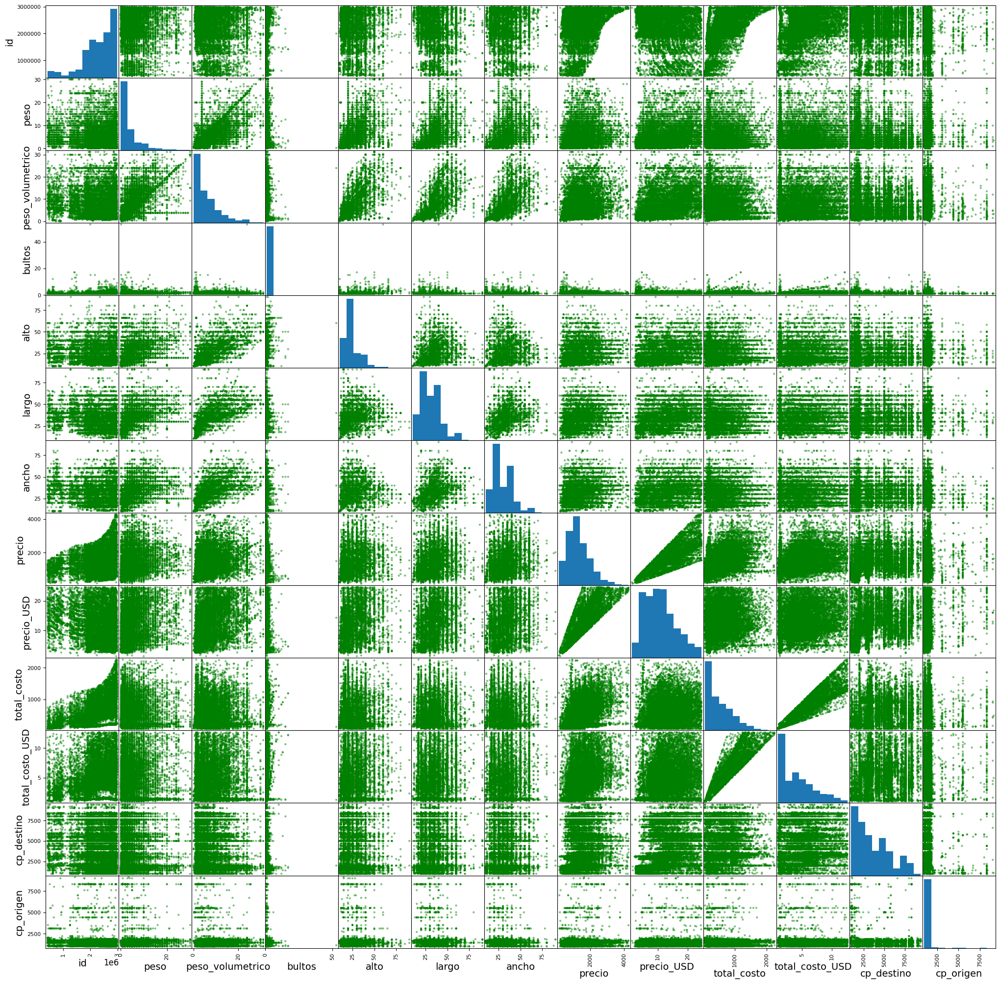

In [54]:
pd.plotting.scatter_matrix(df_filtro_3, figsize=(25,25), color='green')
plt.show()

In [55]:
df_corr = abs(X.corrwith(y))
display(df_corr.sort_values(ascending=False).to_frame())

,0
total_costo_USD,0.436966
peso_volumetrico,0.416477
cp_destino,0.407515
largo,0.333677
ancho,0.301845
peso,0.294827
alto,0.293350
cp_origen,0.052591
bultos,0.033641


En su núcleo los algoritmos de ML procesan números. Por lo tanto se han inventado varias soluciones para poder mapear variables categóricas (texto,clases, colores) a variables númericas. Para pasar esta variable al modelo necesitamos "encodear" o codificar de alguna manera sus valores.

En la siguiente celda cargamos el `LabelEncoder` de `sklearn` y se lo aplicamos a nuestros datos.

In [56]:
categorical_columns = ['provincia_destino','provincia_origen']
le = LabelEncoder()

for column in categorical_columns:
    X[column] = le.fit_transform(X[column])
    X.head() 

In [57]:
df_corr = abs(X.corrwith(y))
display(df_corr.sort_values(ascending=False).to_frame())

,0
total_costo_USD,0.436966
peso_volumetrico,0.416477
cp_destino,0.407515
provincia_destino,0.333785
largo,0.333677
ancho,0.301845
peso,0.294827
alto,0.293350
provincia_origen,0.094288
cp_origen,0.052591



Dado que tu variable objetivo es "precio_USD" y segun las correlaciones, algunas ideas para crear nuevas variables basadas en esas características son:

* **`'volumen_total'`**: Calcular el volumen total de los envíos multiplicando las variables "largo", "alto" y "ancho". Esto podría ser relevante si el tamaño de los envíos afecta el precio.

* **`'costo_promedio_bulto'`**: Calcular el costo promedio por bulto dividiendo `"total_costo_USD"` entre `"bultos"`. Esto podría ayudar a entender el costo individual por bulto y su relación con el `"precio_USD"`.

In [58]:
X['volumen_total'] = X['largo'] * X['alto'] * X['ancho']
X['costo_promedio_bulto'] = X['total_costo_USD'] / X['bultos']

In [59]:
df_corr = abs(X.corrwith(y))
display(df_corr.sort_values(ascending=False).to_frame())

,0
total_costo_USD,0.436966
costo_promedio_bulto,0.434854
peso_volumetrico,0.416477
cp_destino,0.407515
volumen_total,0.385123
provincia_destino,0.333785
largo,0.333677
ancho,0.301845
peso,0.294827
alto,0.293350


*Preguntas** 
- ¿Qué variables tienen mayor correlación con el target?
    * Las variables que tienen una mayor correlación con el target ("precio_USD") son:
        
        * **costo_promedio_bulto**: `0.434854`
        * **cp_destino**: `0.407515`
        * **provincia_destino**: `0.333785`
        * **total_costo_USD**: `0.436966`

Sin embargo, a pesar de que estas variables tienen una correlación significativa con el objetivo, se utilizarán todas las variables disponibles para el análisis o modelo predictivo. Esto se debe a que la correlación no es el único factor determinante de la importancia de una variable para predecir el objetivo. Las otras variables con correlaciones más bajas aún pueden aportar información relevante y complementaria para mejorar la precisión del modelo.

La inclusión de todas las variables sera útil para evitar la exclusión de características relevantes que podrían afectar el rendimiento del modelo. 

Por lo tanto, el enfoque será utilizar un modelo de aprendizaje automático que tenga la capacidad de considerar todas las variables simultáneamente y determinar su importancia relativa para realizar predicciones precisas y efectivas. De esta manera, se garantiza una visión integral y completa del problema, lo que potencialmente llevará a resultados más sólidos y confiables en la predicción de nuestro objetivo.

## ⏩ **8. <u>Model Building and Training (Construcción y Entrenamiento del Modelo) </u>**

#### **8.1 - Selección del modelo:**

Nuestro objetivo consiste en predecir el precio en dólares estadounidenses **(`'precio_USD'`)** de un paquete, basándonos en sus características: `'alto'`, `'largo'`, `'ancho'`, `'peso'`, `'peso_volumentrico'`, `'cp_origen'`, `'cp_destino'`, `'provincia_origen'` y `'provincia_destino'`. Dado que estamos tratando con una variable continua, es apropiado utilizar modelos de regresión para este propósito.

Para este proyecto, hemos decidido evaluar varios algoritmos de regresión, entre ellos:

* **`LinearRegression`**: Un modelo clásico que busca establecer una relación lineal entre las características y la variable objetivo.

* **`KNeighborsRegressor`**: Un algoritmo basado en vecinos más cercanos, que encuentra los k ejemplos más cercanos en el conjunto de entrenamiento para realizar una predicción.

* **`RandomForestRegressor`**: Un modelo de Bosques Aleatorios que combina múltiples árboles de decisión para obtener resultados más precisos y robustos.

* **`XGBRegressor`**: Un algoritmo de refuerzo (boosting) conocido como Gradient Boosting, que crea un conjunto de árboles de decisión y los combina para mejorar la predicción final.

* **`Gradient Boosting Regressor`**: Además de XGBRegressor, existen otros algoritmos de refuerzo que puedes probar, como el GradientBoostingRegressor de la librería Scikit-learn.

* **`ElasticNet`**: Una combinación de regresión de Ridge y regresión LASSO, que utiliza tanto regularización L1 como L2 para abordar problemas de multicolinealidad y realizar selección de características.

* **`LightGBM Regressor`**: Otro algoritmo de refuerzo (boosting) similar a XGBoost, pero conocido por su alta eficiencia y velocidad en conjuntos de datos grandes.

* **`CatBoost Regressor`**: Un algoritmo de refuerzo desarrollado por Yandex, que destaca por su manejo natural de características categóricas y su rendimiento robusto.

Al evaluar estos modelos, esperamos seleccionar aquel que brinde la mejor precisión y capacidad de generalización en nuestro conjunto de datos. A través del proceso de entrenamiento y ajuste de hiperparámetros, buscamos obtener un modelo que pueda realizar predicciones confiables sobre el precio_USD de paquetes con diferentes características. 

#### **8.2 - División del conjunto de datos:**

Es una buena práctica dividir tus datos en conjuntos separados para entrenamiento y evaluación del modelo asi como separar el conjunto de entrenamiento en otro conjunto de entrenamiento y un conjunto de validación,

In [61]:
X2 = X[['peso', 'peso_volumetrico','alto', 'ancho', 'cp_destino', 'provincia_origen', 'cp_destino', 'provincia_destino', 'largo']]

In [62]:
# Dividir los datos en conjunto de entrenamiento y prueba (80% para entrenamiento, 20% para prueba)
X_train_full, X_test, y_train_full, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Dividir el conjunto de entrenamiento en entrenamiento y validación (80% para entrenamiento, 30% para validación)
X_train, X_val, y_train, y_val = train_test_split(X_train_full, y_train_full, test_size=0.2, random_state=42)

# Verificar las longitudes de los nuevos conjuntos de datos
print("Longitud de X_train:", len(X_train))
print("Longitud de y_train:", len(y_train))
print("Longitud de X_val:", len(X_val))
print("Longitud de y_val:", len(y_val))

Longitud de X_train: 14841
Longitud de y_train: 14841
Longitud de X_val: 3711
Longitud de y_val: 3711


Aquí dejamos una breve descripción de cada conjunto de datos:

* **`X_train_full`**: Conjunto de características de entrenamiento completo, que se utilizará para entrenar los modelos. Contiene el 80% de los datos originales.

* **`X_test`**: Conjunto de características de prueba, que se utilizará para evaluar el rendimiento final del modelo. Contiene el 20% de los datos originales y no se utiliza durante el entrenamiento.

* **`y_train_full`**: Conjunto de objetivos de entrenamiento completo, que corresponde a los valores objetivo para el conjunto de **X_train_full**.

* **`y_test`**: Conjunto de objetivos de prueba, que corresponde a los valores objetivo para el conjunto de **X_test**.

* **`X_train`**: Conjunto de características de entrenamiento nuevo, obtenido al dividir **X_train_full**. Se utiliza para ajustar y validar los modelos durante el desarrollo.

* **`X_val`**: Conjunto de características de validación, que se utiliza para evaluar el rendimiento y ajustar los hiperparámetros de los modelos durante el desarrollo. Contiene el 30% de los datos de **X_train_full**.

* **`y_train`**: Conjunto de objetivos de entrenamiento nuevo, obtenido al dividir **y_train_full**. Corresponde a los valores objetivo para el conjunto de **X_train_new**.

* **`y_val`**: Conjunto de objetivos de validación, que se utiliza para evaluar el rendimiento y ajustar los hiperparámetros de los modelos durante el desarrollo. Corresponde a los valores objetivo para el conjunto de **X_val**.

#### **8.3 - Entrenamiento del modelo:** 

##### **8.3.1 - LinearRegression**

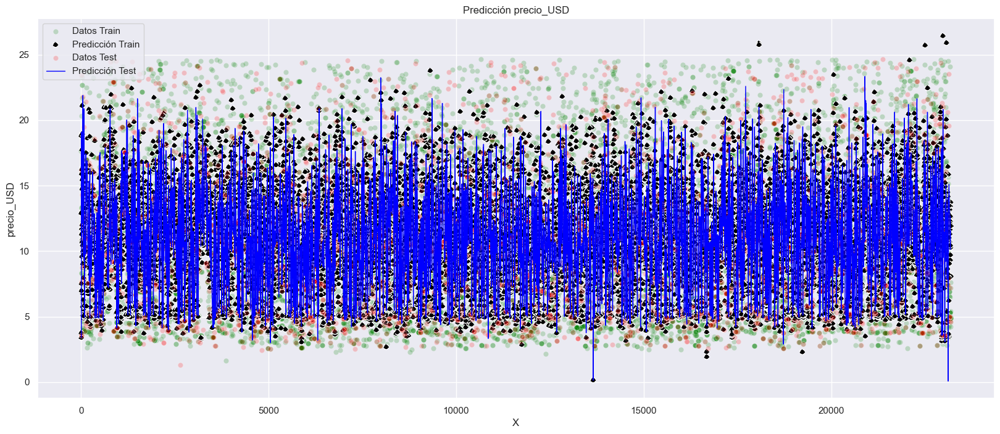

Error cuadrático medio (MSE) en datos de entrenamiento: 12.67
Error cuadrático medio (MSE) en datos de prueba: 12.6
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 3.56
Raíz del error cuadrático medio (RMSE) en datos de prueba: 3.55
R-cuadrado (R²) en datos de entrenamiento: 0.51
R-cuadrado (R²) en datos de prueba: 0.54
Error absoluto medio (MAE) en datos de entrenamiento: 2.57
Error absoluto medio (MAE) en datos de prueba: 2.58


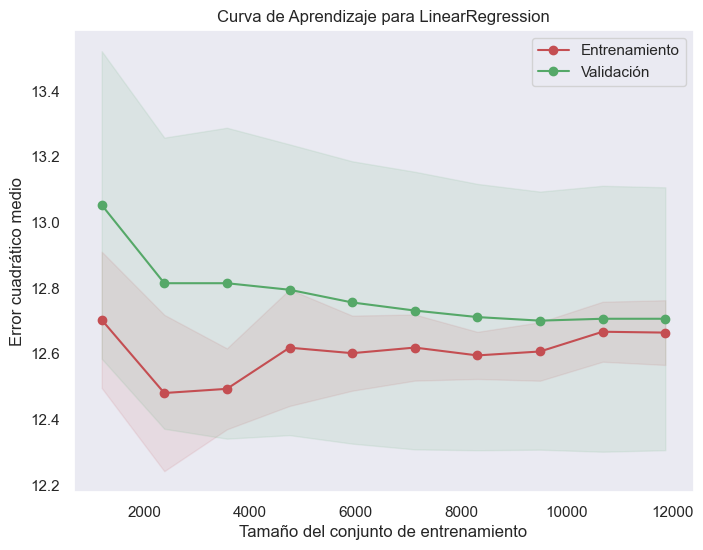

Resultados para LinearRegression:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              12.7032           13.0529
                     2374              12.4805           12.8147
                     3561              12.4932           12.8147
                     4748              12.6184           12.7947
                     5936              12.6017           12.7561
                     7123              12.6188           12.7314
                     8310              12.5949           12.7116
                     9497              12.6069           12.7007
                    10684              12.667            12.7065
                    11872              12.6643           12.7065


In [63]:
model_lr = LinearRegression()
model_lr.fit(X_train, y_train)
y_train_pred_lr = model_lr.predict(X_train)
y_val_pred_lr = model_lr.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_lr.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_lr.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

lr_mse_train = mean_squared_error(y_train, y_train_pred_lr)
lr_mse_val = mean_squared_error(y_val, y_val_pred_lr)

lr_rmse_train = np.sqrt(lr_mse_train)
lr_rmse_val = np.sqrt(lr_mse_val)

lr_r2_train = r2_score(y_train, y_train_pred_lr)
lr_r2_val = r2_score(y_val, y_val_pred_lr)

lr_mae_train = mean_absolute_error(y_train, y_train_pred_lr)
lr_mae_val = mean_absolute_error(y_val, y_val_pred_lr)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(lr_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(lr_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(lr_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(lr_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(lr_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(lr_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(lr_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(lr_mae_val,2))


# Obtener la curva de aprendizaje para el modelo de LinearRegression
train_sizes_lr, train_scores_lr, test_scores_lr = learning_curve(
    estimator=model_lr,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_lr = -np.mean(train_scores_lr, axis=1)
train_scores_std_lr = np.std(train_scores_lr, axis=1)
test_scores_mean_lr = -np.mean(test_scores_lr, axis=1)
test_scores_std_lr = np.std(test_scores_lr, axis=1)

# Crear una lista para almacenar los resultados
results_lr = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_lr):
    results_lr.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_lr[i],
        'MSE Validación': test_scores_mean_lr[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para LinearRegression
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para LinearRegression")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_lr, train_scores_mean_lr - train_scores_std_lr,
                 train_scores_mean_lr + train_scores_std_lr, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_lr, test_scores_mean_lr - test_scores_std_lr,
                 test_scores_mean_lr + test_scores_std_lr, alpha=0.1, color="g")
plt.plot(train_sizes_lr, train_scores_mean_lr, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_lr, test_scores_mean_lr, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_lr = pd.DataFrame(results_lr)

# Imprimir la tabla de resultados
print("Resultados para LinearRegression:")
print(tabulate(results_lr, headers='keys'))



El modelo **`LinearRegression`** muestra un rendimiento moderado en la predicción del precio del PACK. El valor `R²` de aproximadamente *0.54* en los datos de prueba indica que el modelo explica el *0.50* de la variabilidad en los precios. Sin embargo, el `RMSE` y el `MAE` son relativamente altos, con un promedio de error de aproximadamente *3.55* y *2.58* unidades respectivamente. Esto sugiere que el modelo no logra capturar completamente la relación entre las características y el precio del pack.


**Curva de aprendizaje:** La curva de aprendizaje muestra que a medida que aumenta el tamaño del conjunto de entrenamiento, el `MSE` de entrenamiento y validación tiende a converger a un valor cercano. Sin embargo, ambos errores siguen siendo relativamente altos, lo que indica que el modelo puede beneficiarse de más datos o mejor ajuste de hiperparámetros.

##### **8.3.2 - KNeighborsRegressor**

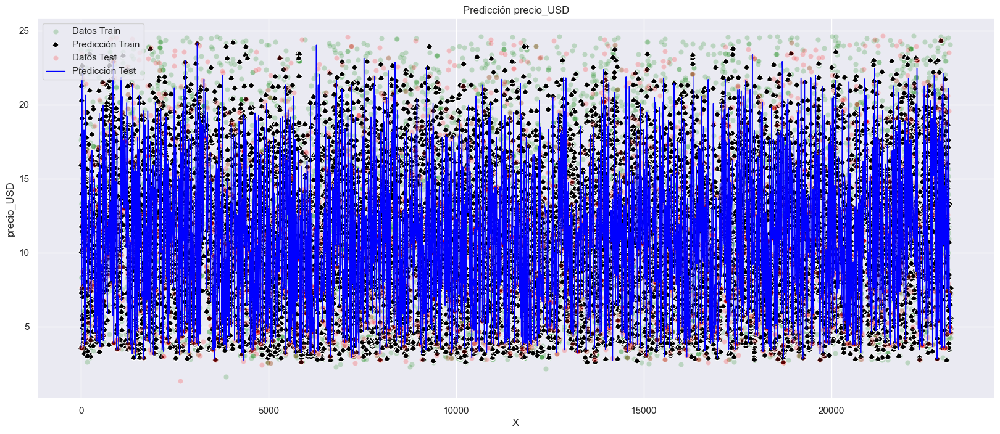

Error cuadrático medio (MSE) en datos de entrenamiento: 4.59
Error cuadrático medio (MSE) en datos de prueba: 9.47
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 2.14
Raíz del error cuadrático medio (RMSE) en datos de prueba: 3.08
R-cuadrado (R²) en datos de entrenamiento: 0.82
R-cuadrado (R²) en datos de prueba: 0.65
Error absoluto medio (MAE) en datos de entrenamiento: 1.17
Error absoluto medio (MAE) en datos de prueba: 1.75


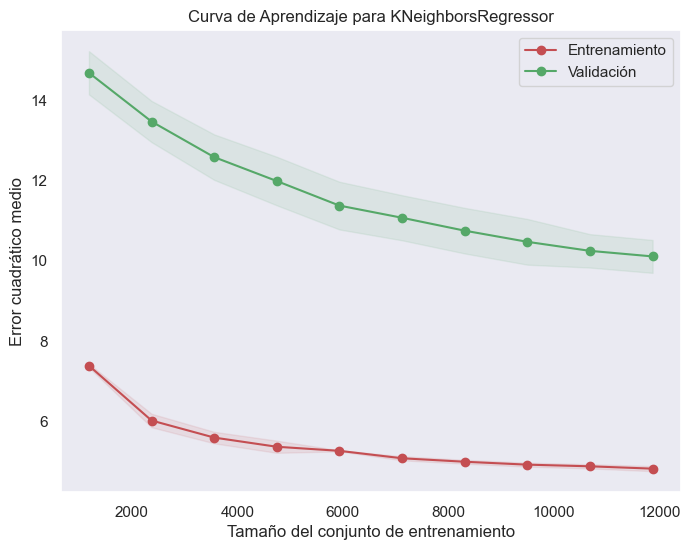

Resultados para KNeighborsRegressor:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              7.38133           14.6918
                     2374              6.01241           13.4759
                     3561              5.58636           12.5872
                     4748              5.35731           11.9901
                     5936              5.25526           11.3771
                     7123              5.06981           11.0735
                     8310              4.98298           10.7514
                     9497              4.91047           10.4734
                    10684              4.8692            10.2476
                    11872              4.8108            10.1086


In [64]:
model_kn = KNeighborsRegressor(n_neighbors=3)
model_kn.fit(X_train, y_train)
y_train_pred_kn = model_kn.predict(X_train)
y_val_pred_kn = model_kn.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_kn.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_kn.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

kn_mse_train = mean_squared_error(y_train, y_train_pred_kn)
kn_mse_val = mean_squared_error(y_val, y_val_pred_kn)

kn_rmse_train = np.sqrt(kn_mse_train)
kn_rmse_val = np.sqrt(kn_mse_val)

kn_r2_train = r2_score(y_train, y_train_pred_kn)
kn_r2_val = r2_score(y_val, y_val_pred_kn)

kn_mae_train = mean_absolute_error(y_train, y_train_pred_kn)
kn_mae_val = mean_absolute_error(y_val, y_val_pred_kn)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(kn_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(kn_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(kn_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(kn_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(kn_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(kn_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(kn_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(kn_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de KNeighborsRegressor
train_sizes_kn, train_scores_kn, test_scores_kn = learning_curve(
    estimator=model_kn,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_kn = -np.mean(train_scores_kn, axis=1)
train_scores_std_kn = np.std(train_scores_kn, axis=1)
test_scores_mean_kn = -np.mean(test_scores_kn, axis=1)
test_scores_std_kn = np.std(test_scores_kn, axis=1)

# Crear una lista para almacenar los resultados
results_kn = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_kn):
    results_kn.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_kn[i],
        'MSE Validación': test_scores_mean_kn[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para KNeighborsRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para KNeighborsRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_kn, train_scores_mean_kn - train_scores_std_kn,
                 train_scores_mean_kn + train_scores_std_kn, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_kn, test_scores_mean_kn - test_scores_std_kn,
                 test_scores_mean_kn + test_scores_std_kn, alpha=0.1, color="g")
plt.plot(train_sizes_kn, train_scores_mean_kn, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_kn, test_scores_mean_kn, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_kn = pd.DataFrame(results_kn)

# Imprimir la tabla de resultados
print("Resultados para KNeighborsRegressor:")
print(tabulate(results_kn, headers='keys'))


Este modelo **'KNeighborsRegressor'** presenta un mejor rendimiento en comparación con **`LinearRegression`**. El valor `R²` de aproximadamente *0.65* en datos de prueba muestra que explica una mayor variabilidad en los precios. Además, el `RMSE` y `MAE` son menores, con un error promedio de aproximadamente *3.08* y *1.75* unidades respectivamente. Estos resultados indican que el modelo **`KNeighborsRegressor`** tiene una mayor precisión en sus predicciones en comparación con **`LinearRegression`**.


**Curva de aprendizaje:** La curva de aprendizaje muestra que a medida que aumenta el tamaño del conjunto de entrenamiento, tanto el `MSE` de entrenamiento como el de validación tienden a disminuir y estabilizarse. Esto sugiere que el modelo **`KNeighborsRegressor`** se beneficia del aumento de datos y puede seguir mejorando con más ejemplos de entrenamiento.

##### **8.3.3 - RandomForestRegressor**

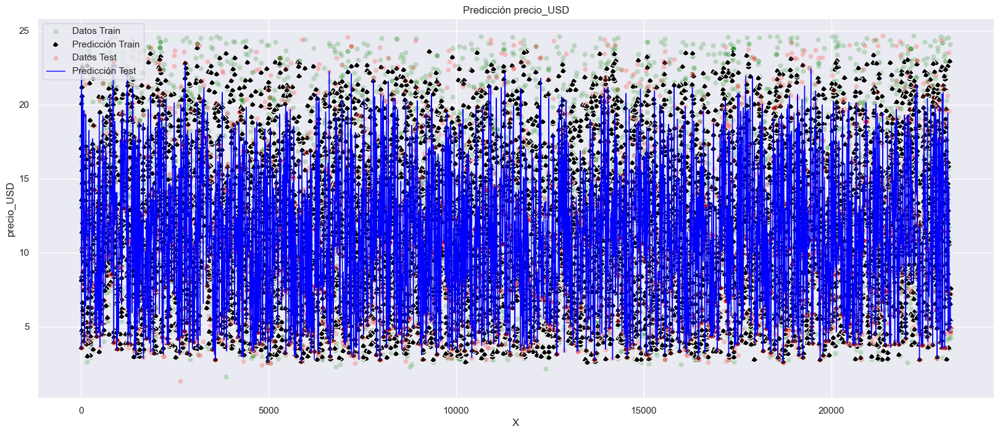

Error cuadrático medio (MSE) en datos de entrenamiento: 0.69
Error cuadrático medio (MSE) en datos de prueba: 4.92
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 0.83
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.22
R-cuadrado (R²) en datos de entrenamiento: 0.97
R-cuadrado (R²) en datos de prueba: 0.82
Error absoluto medio (MAE) en datos de entrenamiento: 0.44
Error absoluto medio (MAE) en datos de prueba: 1.19


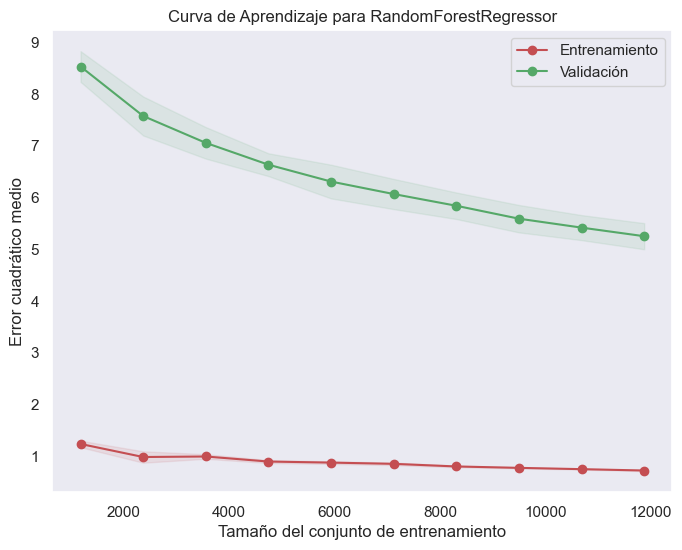

Resultados para RandomForestRegressor:
      Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
--  -------------------------  -------------------  ----------------
 0                       1187             1.23731            8.52855
 1                       2374             0.985167           7.57269
 2                       3561             0.995154           7.05379
 3                       4748             0.897694           6.63225
 4                       5936             0.877216           6.30631
 5                       7123             0.853238           6.06531
 6                       8310             0.802605           5.83878
 7                       9497             0.77557            5.58918
 8                      10684             0.750574           5.41662
 9                      11872             0.724265           5.25061


In [65]:
model_rf = RandomForestRegressor(n_estimators=100, random_state=42)
model_rf.fit(X_train, y_train)
y_train_pred_rf = model_rf.predict(X_train)
y_val_pred_rf = model_rf.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_rf.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_rf.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

rf_mse_train = mean_squared_error(y_train, y_train_pred_rf)
rf_mse_val = mean_squared_error(y_val, y_val_pred_rf)

rf_rmse_train = np.sqrt(rf_mse_train)
rf_rmse_val = np.sqrt(rf_mse_val)

rf_r2_train = r2_score(y_train, y_train_pred_rf)
rf_r2_val = r2_score(y_val, y_val_pred_rf)

rf_mae_train = mean_absolute_error(y_train, y_train_pred_rf)
rf_mae_val = mean_absolute_error(y_val, y_val_pred_rf)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(rf_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(rf_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(rf_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(rf_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(rf_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(rf_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(rf_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(rf_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de RandomForestRegressor
train_sizes_rf, train_scores_rf, test_scores_rf = learning_curve(
    estimator=model_rf,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_rf = -np.mean(train_scores_rf, axis=1)
train_scores_std_rf = np.std(train_scores_rf, axis=1)
test_scores_mean_rf = -np.mean(test_scores_rf, axis=1)
test_scores_std_rf = np.std(test_scores_rf, axis=1)

# Crear una lista para almacenar los resultados
results_rf = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_rf):
    results_rf.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_rf[i],
        'MSE Validación': test_scores_mean_rf[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para RandomForestRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para RandomForestRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_rf, train_scores_mean_rf - train_scores_std_rf,
                 train_scores_mean_rf + train_scores_std_rf, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_rf, test_scores_mean_rf - test_scores_std_rf,
                 test_scores_mean_rf + test_scores_std_rf, alpha=0.1, color="g")
plt.plot(train_sizes_rf, train_scores_mean_rf, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_rf, test_scores_mean_rf, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_rf = pd.DataFrame(results_rf)

# Imprimir la tabla de resultados
print("Resultados para RandomForestRegressor:")
print(tabulate(df_results_rf, headers='keys'))



El modelo **`RandomForestRegressor`** muestra un rendimiento notablemente mejor que **`LinearRegression`** y **`KNeighborsRegressor`**. El valor `R²` de aproximadamente *0.82* en datos de prueba indica que es capaz de explicar una gran parte de la variabilidad en los precios. Además, tanto el `RMSE` como el `MAE` son menores, con errores promedio de aproximadamente *2.22* y *1.19* unidades respectivamente. Estos resultados indican que el modelo **`RandomForestRegressor`** ofrece predicciones más precisas y robustas.


**Curva de aprendizaje:** La curva de aprendizaje muestra que a medida que aumenta el tamaño del conjunto de entrenamiento, tanto el `MSE` de entrenamiento como el de validación disminuyen y tienden a estabilizarse. Esto sugiere que el modelo **`RandomForestRegressor`** está aprendiendo de manera efectiva de los datos disponibles y no muestra signos de sobreajuste.

##### **8.3.4 - XGBRegressor**

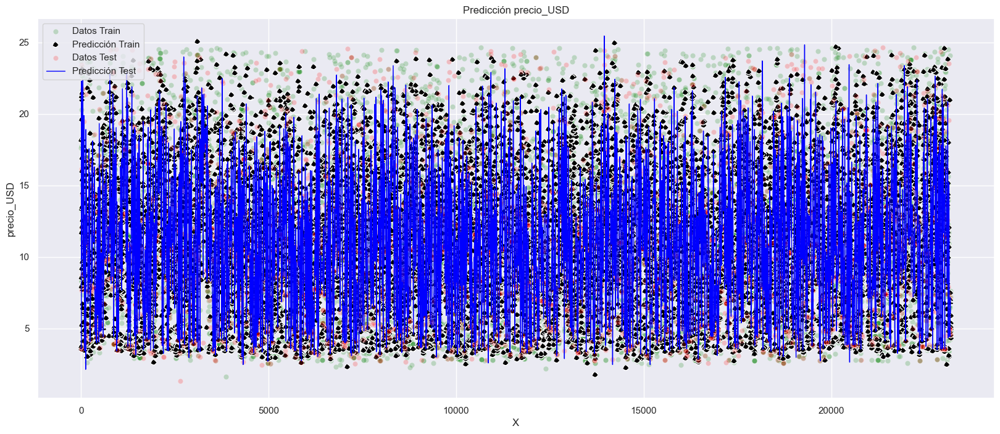

Error cuadrático medio (MSE) en datos de entrenamiento: 1.87
Error cuadrático medio (MSE) en datos de prueba: 4.98
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 1.37
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.23
R-cuadrado (R²) en datos de entrenamiento: 0.93
R-cuadrado (R²) en datos de prueba: 0.82
Error absoluto medio (MAE) en datos de entrenamiento: 0.88
Error absoluto medio (MAE) en datos de prueba: 1.34


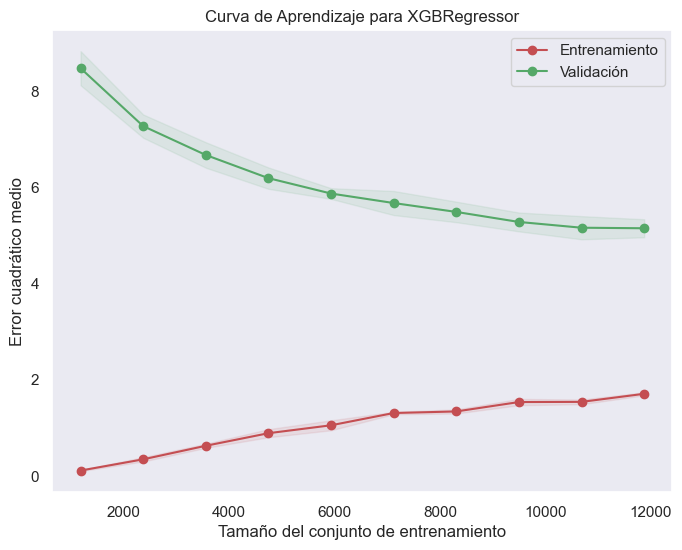

Resultados para XGBRegressor:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187             0.114144           8.47626
                     2374             0.347512           7.27282
                     3561             0.629021           6.67283
                     4748             0.890339           6.19157
                     5936             1.05514            5.87136
                     7123             1.31002            5.67412
                     8310             1.34277            5.48917
                     9497             1.53797            5.2809
                    10684             1.54144            5.16108
                    11872             1.7094             5.14994


In [66]:
model_xgb = xgb.XGBRegressor(n_estimators=100, random_state=42)
model_xgb.fit(X_train, y_train)
y_train_pred_xgb = model_xgb.predict(X_train)
y_val_pred_xgb = model_xgb.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_xgb.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_xgb.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

xgb_mse_train = mean_squared_error(y_train, y_train_pred_xgb)
xgb_mse_val = mean_squared_error(y_val, y_val_pred_xgb)

xgb_rmse_train = np.sqrt(xgb_mse_train)
xgb_rmse_val = np.sqrt(xgb_mse_val)

xgb_r2_train = r2_score(y_train, y_train_pred_xgb)
xgb_r2_val = r2_score(y_val, y_val_pred_xgb)

xgb_mae_train = mean_absolute_error(y_train, y_train_pred_xgb)
xgb_mae_val = mean_absolute_error(y_val, y_val_pred_xgb)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(xgb_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(xgb_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(xgb_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(xgb_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(xgb_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(xgb_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(xgb_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(xgb_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de XGBRegressor
train_sizes_xgb, train_scores_xgb, test_scores_xgb = learning_curve(
    estimator=model_xgb,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_xgb = -np.mean(train_scores_xgb, axis=1)
train_scores_std_xgb = np.std(train_scores_xgb, axis=1)
test_scores_mean_xgb = -np.mean(test_scores_xgb, axis=1)
test_scores_std_xgb = np.std(test_scores_xgb, axis=1)

# Crear una lista para almacenar los resultados
results_xgb = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_xgb):
    results_xgb.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_xgb[i],
        'MSE Validación': test_scores_mean_xgb[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para XGBRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para XGBRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_xgb, train_scores_mean_xgb - train_scores_std_xgb,
                 train_scores_mean_xgb + train_scores_std_xgb, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_xgb, test_scores_mean_xgb - test_scores_std_xgb,
                 test_scores_mean_xgb + test_scores_std_xgb, alpha=0.1, color="g")
plt.plot(train_sizes_xgb, train_scores_mean_xgb, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_xgb, test_scores_mean_xgb, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_xgb = pd.DataFrame(results_xgb)

# Imprimir la tabla de resultados
print("Resultados para XGBRegressor:")
print(tabulate(results_xgb, headers='keys'))

El modelo **`XGBRegressor`** también presenta un rendimiento sólido en la predicción del precio del PACK. El valor `R²` de aproximadamente *0.82* en datos de prueba indica una buena capacidad para explicar la variabilidad en los precios. Además, el `RMSE` y el `MAE` son menores, con errores promedio de aproximadamente *2.23* y *1.34* unidades respectivamente. Estos resultados sugieren que el modelo **`XGBRegressor`** es una opción viable para realizar predicciones precisas.


**Curva de aprendizaje:** La curva de aprendizaje muestra una tendencia similar a otros modelos, con el `MSE` de entrenamiento y validación disminuyendo a medida que aumenta el tamaño del conjunto de entrenamiento. Esto indica que el modelo **XGBRegressor** también se beneficia del aumento de datos y puede continuar mejorando con más ejemplos de entrenamiento.

##### **8.3.5 - Gradient Boosting Regressor**

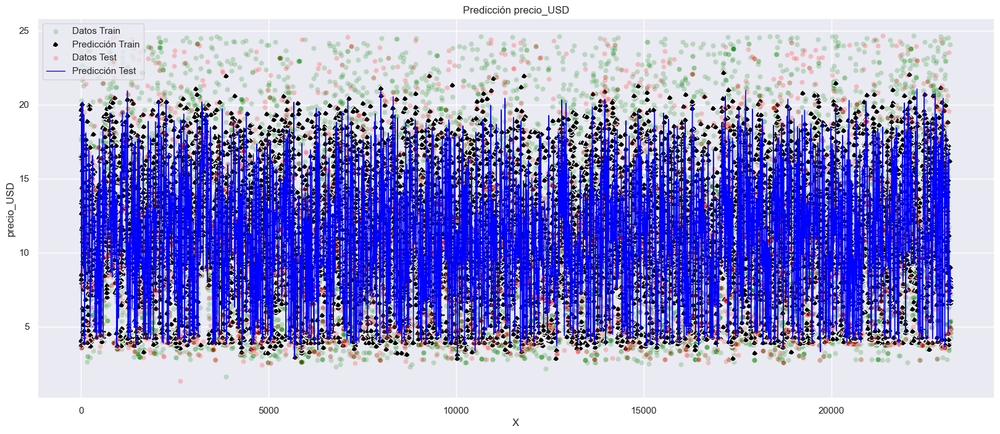

Error cuadrático medio (MSE) en datos de entrenamiento: 7.04
Error cuadrático medio (MSE) en datos de prueba: 7.35
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 2.65
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.71
R-cuadrado (R²) en datos de entrenamiento: 0.73
R-cuadrado (R²) en datos de prueba: 0.73
Error absoluto medio (MAE) en datos de entrenamiento: 1.81
Error absoluto medio (MAE) en datos de prueba: 1.85


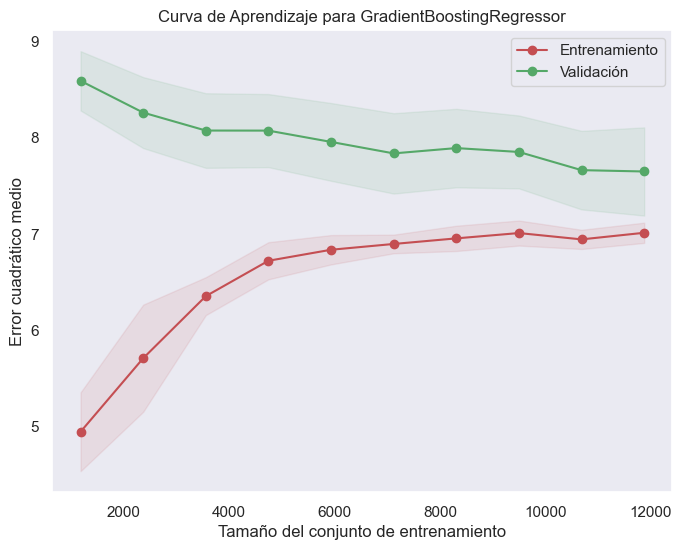

Resultados para GradientBoostingRegressor:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              4.94773           8.58487
                     2374              5.7099            8.25576
                     3561              6.3532            8.06974
                     4748              6.72009           8.0691
                     5936              6.83438           7.95188
                     7123              6.89432           7.8329
                     8310              6.95223           7.88795
                     9497              7.00741           7.84782
                    10684              6.94182           7.65937
                    11872              7.01018           7.64546


In [67]:
model_gb = GradientBoostingRegressor()
model_gb.fit(X_train, y_train)
y_train_pred_gb = model_gb.predict(X_train)
y_val_pred_gb = model_gb.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_gb.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_gb.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

gb_mse_train = mean_squared_error(y_train, y_train_pred_gb)
gb_mse_val = mean_squared_error(y_val, y_val_pred_gb)

gb_rmse_train = np.sqrt(gb_mse_train)
gb_rmse_val = np.sqrt(gb_mse_val)

gb_r2_train = r2_score(y_train, y_train_pred_gb)
gb_r2_val = r2_score(y_val, y_val_pred_gb)

gb_mae_train = mean_absolute_error(y_train, y_train_pred_gb)
gb_mae_val = mean_absolute_error(y_val, y_val_pred_gb)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(gb_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(gb_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(gb_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(gb_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(gb_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(gb_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(gb_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(gb_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de GradientBoostingRegressor
train_sizes_gb, train_scores_gb, test_scores_gb = learning_curve(
    estimator=model_gb,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_gb = -np.mean(train_scores_gb, axis=1)
train_scores_std_gb = np.std(train_scores_gb, axis=1)
test_scores_mean_gb = -np.mean(test_scores_gb, axis=1)
test_scores_std_gb = np.std(test_scores_gb, axis=1)

# Crear una lista para almacenar los resultados
results_gb = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_gb):
    results_gb.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_gb[i],
        'MSE Validación': test_scores_mean_gb[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para GradientBoostingRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para GradientBoostingRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_gb, train_scores_mean_gb - train_scores_std_gb,
                 train_scores_mean_gb + train_scores_std_gb, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_gb, test_scores_mean_gb - test_scores_std_gb,
                 test_scores_mean_gb + test_scores_std_gb, alpha=0.1, color="g")
plt.plot(train_sizes_gb, train_scores_mean_gb, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_gb, test_scores_mean_gb, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_gb = pd.DataFrame(results_gb)

# Imprimir la tabla de resultados
print("Resultados para GradientBoostingRegressor:")
print(tabulate(results_gb, headers='keys'))

El modelo **`GradientBoostingRegressor`** también muestra un buen rendimiento en la predicción del precio del `PACK`. El valor `R²` de aproximadamente *0.73* en datos de prueba indica una capacidad razonable para explicar la variabilidad en los precios. Sin embargo, en comparación con **`RandomForestRegressor`** y **`XGBRegressor`**, los errores son un poco mayores, con un `RMSE` de aproximadamente *2.71* y un `MAE` de aproximadamente *1.85* unidades. Aunque sigue siendo un buen modelo, puede haber margen de mejora en términos de precisión.


**Curva de aprendizaje:** La curva de aprendizaje muestra una convergencia similar a otros modelos, aunque con un `MSE` de validación ligeramente más alto. Esto sugiere que el modelo puede beneficiarse de más datos para obtener un mejor rendimiento.

##### **8.3.6 - ElasticNet Regressor**

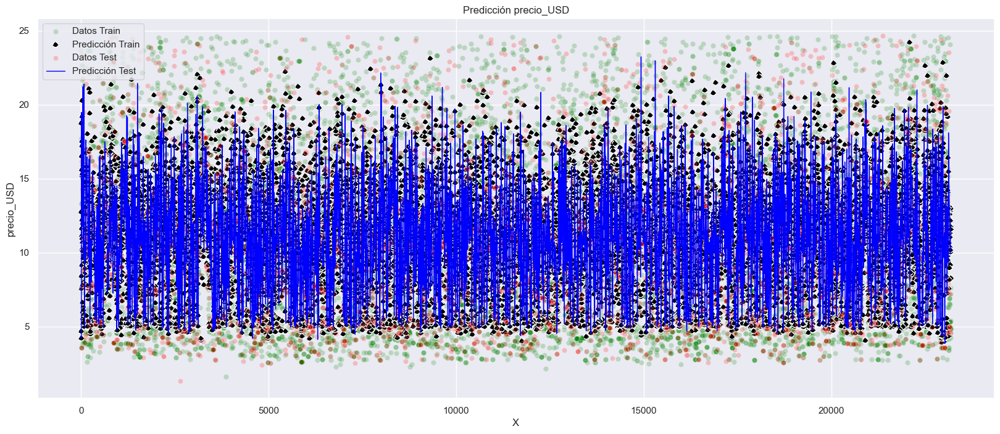

Error cuadrático medio (MSE) en datos de entrenamiento: 13.04
Error cuadrático medio (MSE) en datos de prueba: 12.88
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 3.61
Raíz del error cuadrático medio (RMSE) en datos de prueba: 3.59
R-cuadrado (R²) en datos de entrenamiento: 0.5
R-cuadrado (R²) en datos de prueba: 0.53
Error absoluto medio (MAE) en datos de entrenamiento: 2.66
Error absoluto medio (MAE) en datos de prueba: 2.66


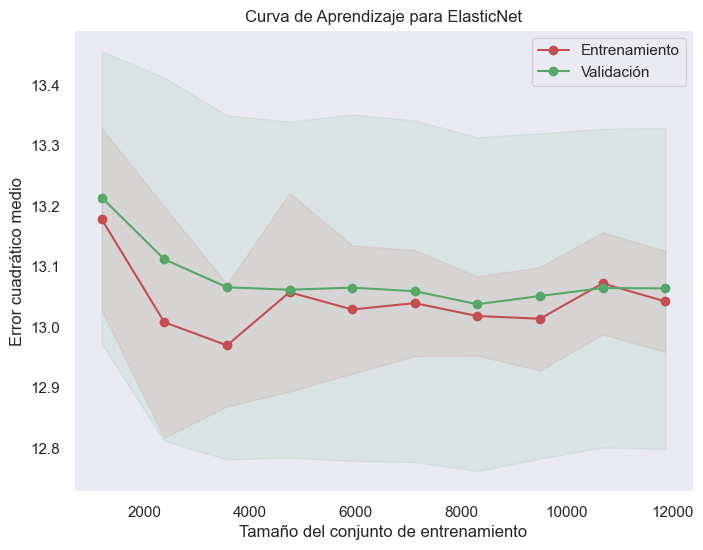

Resultados para ElasticNet:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              13.1783           13.2142
                     2374              13.0083           13.1121
                     3561              12.97             13.066
                     4748              13.0577           13.0619
                     5936              13.0293           13.0653
                     7123              13.0397           13.0594
                     8310              13.0184           13.038
                     9497              13.014            13.0515
                    10684              13.0724           13.0647
                    11872              13.0426           13.0641


In [68]:
model_en = ElasticNet()
model_en.fit(X_train, y_train)
y_train_pred_en = model_en.predict(X_train)
y_val_pred_en = model_en.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_en.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_en.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

en_mse_train = mean_squared_error(y_train, y_train_pred_en)
en_mse_val = mean_squared_error(y_val, y_val_pred_en)

en_rmse_train = np.sqrt(en_mse_train)
en_rmse_val = np.sqrt(en_mse_val)

en_r2_train = r2_score(y_train, y_train_pred_en)
en_r2_val = r2_score(y_val, y_val_pred_en)

en_mae_train = mean_absolute_error(y_train, y_train_pred_en)
en_mae_val = mean_absolute_error(y_val, y_val_pred_en)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(en_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(en_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(en_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(en_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(en_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(en_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(en_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(en_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de ElasticNet
train_sizes_en, train_scores_en, test_scores_en = learning_curve(
    estimator=model_en,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_en = -np.mean(train_scores_en, axis=1)
train_scores_std_en = np.std(train_scores_en, axis=1)
test_scores_mean_en = -np.mean(test_scores_en, axis=1)
test_scores_std_en = np.std(test_scores_en, axis=1)

# Crear una lista para almacenar los resultados
results_en = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_en):
    results_en.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_en[i],
        'MSE Validación': test_scores_mean_en[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para ElasticNet
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para ElasticNet")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_en, train_scores_mean_en - train_scores_std_en,
                 train_scores_mean_en + train_scores_std_en, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_en, test_scores_mean_en - test_scores_std_en,
                 test_scores_mean_en + test_scores_std_en, alpha=0.1, color="g")
plt.plot(train_sizes_en, train_scores_mean_en, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_en, test_scores_mean_en, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_en = pd.DataFrame(results_en)

# Imprimir la tabla de resultados
print("Resultados para ElasticNet:")
print(tabulate(results_en, headers='keys'))

El modelo **`ElasticNet`** muestra el rendimiento más bajo en comparación con otros modelos. El valor `R²` de aproximadamente *0.53* en datos de prueba indica que tiene dificultades para explicar la variabilidad en los precios. Además, tanto el `RMSE` como el `MAE` son altos, con errores promedio de aproximadamente *3.59* y *2.66* unidades respectivamente. Esto sugiere que el modelo no está capturando adecuadamente la complejidad del problema y puede no ser la mejor opción para este conjunto de datos.


**Curva de aprendizaje:** La curva de aprendizaje muestra que el modelo muestra un `MSE` de entrenamiento y validación considerablemente alto en comparación con otros modelos. Esto indica que puede estar sufriendo de sobreajuste y no está generalizando bien a datos no vistos.

##### **8.3.7 - LightGBM Regressor**

[LightGBM] [Info] Total Bins 1742
[LightGBM] [Info] Number of data points in the train set: 14841, number of used features: 13
[LightGBM] [Info] Start training from score 10.854329


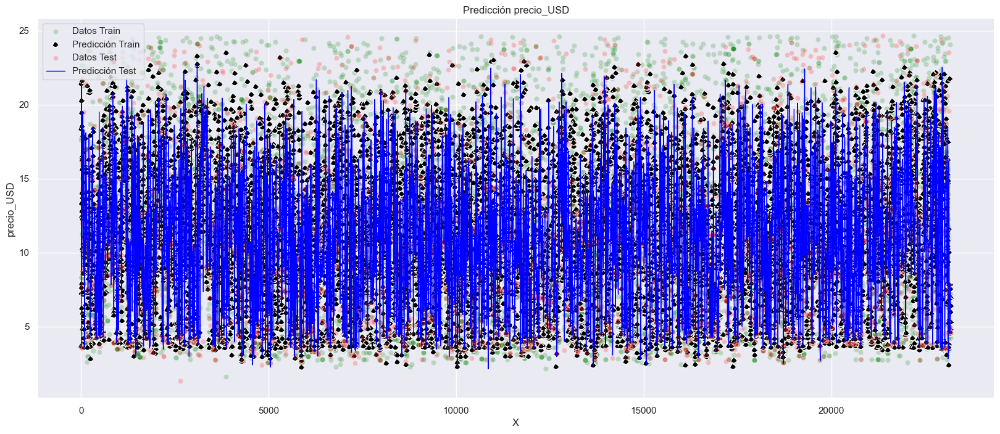

Error cuadrático medio (MSE) en datos de entrenamiento: 3.92
Error cuadrático medio (MSE) en datos de prueba: 5.31
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 1.98
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.31
R-cuadrado (R²) en datos de entrenamiento: 0.85
R-cuadrado (R²) en datos de prueba: 0.8
Error absoluto medio (MAE) en datos de entrenamiento: 1.28
Error absoluto medio (MAE) en datos de prueba: 1.46


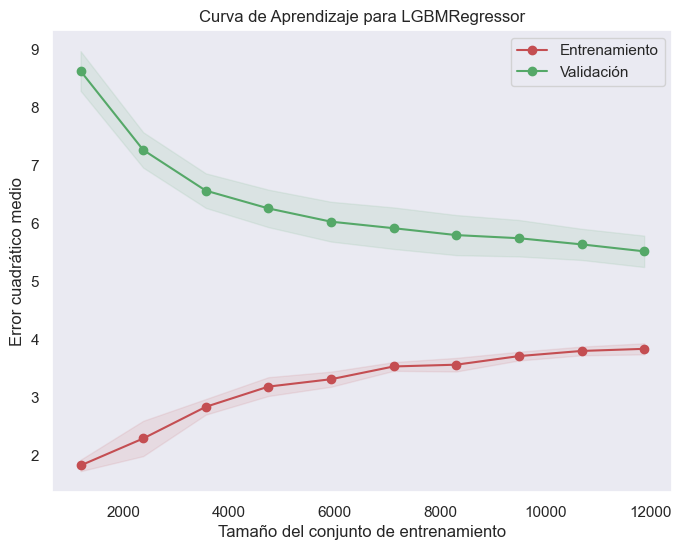

Resultados para LGBMRegressor:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              1.81803           8.62221
                     2374              2.28329           7.26065
                     3561              2.8292            6.55851
                     4748              3.17826           6.25184
                     5936              3.30571           6.02306
                     7123              3.52571           5.91058
                     8310              3.55623           5.79161
                     9497              3.70444           5.73773
                    10684              3.79321           5.6316
                    11872              3.82966           5.51154


In [69]:
# Crear el modelo con threading forzado por fila
#model_lgb = LGBMRegressor(force_row_wise=True)
# o forzado por columna
model_lgb = LGBMRegressor(force_col_wise=True)
model_lgb.fit(X_train, y_train)
y_train_pred_lgb = model_lgb.predict(X_train)
y_val_pred_lgb = model_lgb.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_lgb.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_lgb.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

lgb_mse_train = mean_squared_error(y_train, y_train_pred_lgb)
lgb_mse_val = mean_squared_error(y_val, y_val_pred_lgb)

lgb_rmse_train = np.sqrt(lgb_mse_train)
lgb_rmse_val = np.sqrt(lgb_mse_val)

lgb_r2_train = r2_score(y_train, y_train_pred_lgb)
lgb_r2_val = r2_score(y_val, y_val_pred_lgb)

lgb_mae_train = mean_absolute_error(y_train, y_train_pred_lgb)
lgb_mae_val = mean_absolute_error(y_val, y_val_pred_lgb)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(lgb_mse_train, 2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(lgb_mse_val, 2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(lgb_rmse_train, 2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(lgb_rmse_val, 2))

print('R-cuadrado (R²) en datos de entrenamiento:',round(lgb_r2_train, 2))
print('R-cuadrado (R²) en datos de prueba:', round(lgb_r2_val, 2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(lgb_mae_train, 2))
print('Error absoluto medio (MAE) en datos de prueba:', round(lgb_mae_val, 2))

# Obtener la curva de aprendizaje para el modelo de LGBMRegressor
train_sizes_lgb, train_scores_lgb, test_scores_lgb = learning_curve(
    estimator=model_lgb,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_lgb = -np.mean(train_scores_lgb, axis=1)
train_scores_std_lgb = np.std(train_scores_lgb, axis=1)
test_scores_mean_lgb = -np.mean(test_scores_lgb, axis=1)
test_scores_std_lgb = np.std(test_scores_lgb, axis=1)

# Crear una lista para almacenar los resultados
results_lgb = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_lgb):
    results_lgb.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_lgb[i],
        'MSE Validación': test_scores_mean_lgb[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para LGBMRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para LGBMRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_lgb, train_scores_mean_lgb - train_scores_std_lgb,
                 train_scores_mean_lgb + train_scores_std_lgb, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_lgb, test_scores_mean_lgb - test_scores_std_lgb,
                 test_scores_mean_lgb + test_scores_std_lgb, alpha=0.1, color="g")
plt.plot(train_sizes_lgb, train_scores_mean_lgb, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_lgb, test_scores_mean_lgb, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_lgb = pd.DataFrame(results_lgb)

# Imprimir la tabla de resultados
print("Resultados para LGBMRegressor:")
print(tabulate(results_lgb, headers='keys'))

El modelo **`LGBMRegressor`** muestra un buen rendimiento en la predicción del precio del `PACK`. El valor `R²` de aproximadamente *0.80* en datos de prueba indica una capacidad sólida para explicar la variabilidad en los precios. Además, el `RMSE` y el `MAE` son relativamente bajos, con errores promedio de aproximadamente *2.31* y *1.46* unidades respectivamente. Esto sugiere que el modelo **`LGBMRegressor`** es una opción sólida para realizar predicciones precisas y rápidas.


**Curva de aprendizaje:** La curva de aprendizaje muestra que el `MSE` de entrenamiento y validación tienden a estabilizarse a medida que aumenta el tamaño del conjunto de entrenamiento. Esto indica que el modelo está aprendiendo de manera efectiva y no muestra signos evidentes de sobreajuste.

##### **8.3.8 - CatBoost Regressor**

Learning rate set to 0.0627


0:	learn: 4.9129985	total: 72ms	remaining: 1m 11s
1:	learn: 4.7632132	total: 84.6ms	remaining: 42.2s
2:	learn: 4.6256028	total: 100ms	remaining: 33.2s
3:	learn: 4.4924570	total: 110ms	remaining: 27.3s
4:	learn: 4.3722352	total: 131ms	remaining: 26.1s
5:	learn: 4.2649243	total: 140ms	remaining: 23.2s
6:	learn: 4.1642287	total: 152ms	remaining: 21.6s
7:	learn: 4.0661398	total: 162ms	remaining: 20.1s
8:	learn: 3.9833431	total: 165ms	remaining: 18.2s
9:	learn: 3.8995839	total: 170ms	remaining: 16.8s
10:	learn: 3.8230048	total: 173ms	remaining: 15.5s
11:	learn: 3.7496357	total: 177ms	remaining: 14.6s
12:	learn: 3.6930885	total: 184ms	remaining: 13.9s
13:	learn: 3.6366318	total: 188ms	remaining: 13.3s
14:	learn: 3.5907096	total: 192ms	remaining: 12.6s
15:	learn: 3.5424507	total: 198ms	remaining: 12.2s
16:	learn: 3.4983439	total: 203ms	remaining: 11.7s
17:	learn: 3.4602419	total: 206ms	remaining: 11.3s
18:	learn: 3.4227809	total: 211ms	remaining: 10.9s
19:	learn: 3.3937979	total: 217ms	remain

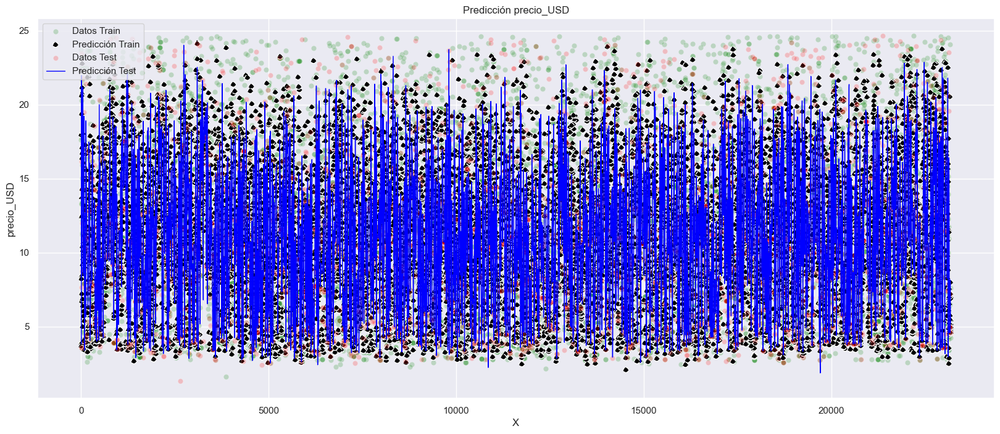

Error cuadrático medio (MSE) en datos de entrenamiento: 3.14
Error cuadrático medio (MSE) en datos de prueba: 5.0
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 1.77
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.24
R-cuadrado (R²) en datos de entrenamiento: 0.88
R-cuadrado (R²) en datos de prueba: 0.82
Error absoluto medio (MAE) en datos de entrenamiento: 1.16
Error absoluto medio (MAE) en datos de prueba: 1.4


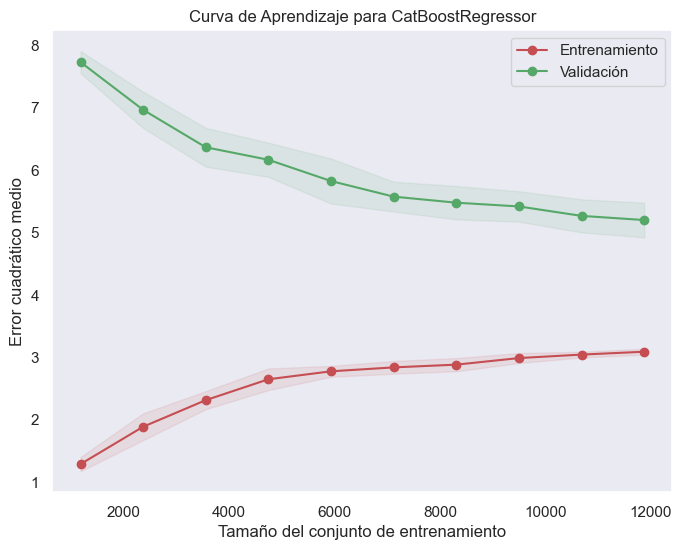

Resultados para CatBoostRegressor:
  Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
-------------------------  -------------------  ----------------
                     1187              1.28972           7.72505
                     2374              1.88812           6.96116
                     3561              2.31358           6.36221
                     4748              2.64784           6.16187
                     5936              2.77533           5.82131
                     7123              2.83818           5.57184
                     8310              2.88198           5.47492
                     9497              2.9873            5.4148
                    10684              3.04291           5.2637
                    11872              3.08881           5.19718


In [70]:
model_cb = CatBoostRegressor()
model_cb.fit(X_train, y_train)
y_train_pred_cb = model_cb.predict(X_train)
y_val_pred_cb = model_cb.predict(X_val)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train.index, y=y_train.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train.index, y=y_train_pred_cb.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_val.index, y=y_val.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_val.index, y=y_val_pred_cb.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

cb_mse_train = mean_squared_error(y_train, y_train_pred_cb)
cb_mse_val = mean_squared_error(y_val, y_val_pred_cb)

cb_rmse_train = np.sqrt(cb_mse_train)
cb_rmse_val = np.sqrt(cb_mse_val)

cb_r2_train = r2_score(y_train, y_train_pred_cb)
cb_r2_val = r2_score(y_val, y_val_pred_cb)

cb_mae_train = mean_absolute_error(y_train, y_train_pred_cb)
cb_mae_val = mean_absolute_error(y_val, y_val_pred_cb)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', round(cb_mse_train,2))
print('Error cuadrático medio (MSE) en datos de prueba:', round(cb_mse_val,2))

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', round(cb_rmse_train,2))
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', round(cb_rmse_val,2))

print('R-cuadrado (R²) en datos de entrenamiento:', round(cb_r2_train,2))
print('R-cuadrado (R²) en datos de prueba:', round(cb_r2_val,2))

print('Error absoluto medio (MAE) en datos de entrenamiento:', round(cb_mae_train,2))
print('Error absoluto medio (MAE) en datos de prueba:', round(cb_mae_val,2))

# Obtener la curva de aprendizaje para el modelo de CatBoostRegressor
train_sizes_cb, train_scores_cb, test_scores_cb = learning_curve(
    estimator=model_cb,
    X=X_train,
    y=y_train,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_cb = -np.mean(train_scores_cb, axis=1)
train_scores_std_cb = np.std(train_scores_cb, axis=1)
test_scores_mean_cb = -np.mean(test_scores_cb, axis=1)
test_scores_std_cb = np.std(test_scores_cb, axis=1)

# Crear una lista para almacenar los resultados
results_cb = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_cb):
    results_cb.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_cb[i],
        'MSE Validación': test_scores_mean_cb[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para CatBoostRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para CatBoostRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_cb, train_scores_mean_cb - train_scores_std_cb,
                 train_scores_mean_cb + train_scores_std_cb, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_cb, test_scores_mean_cb - test_scores_std_cb,
                 test_scores_mean_cb + test_scores_std_cb, alpha=0.1, color="g")
plt.plot(train_sizes_cb, train_scores_mean_cb, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_cb, test_scores_mean_cb, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_cb = pd.DataFrame(results_cb)

# Imprimir la tabla de resultados
print("Resultados para CatBoostRegressor:")
print(tabulate(results_cb, headers='keys'))

El modelo **`CatBoostRegressor`** también muestra un rendimiento sólido en la predicción del precio del `PACK`. El valor `R²` de aproximadamente *0.82* en datos de prueba indica una buena capacidad para explicar la variabilidad en los precios. Además, el `RMSE` y el `MAE` son relativamente bajos, con errores promedio de aproximadamente *2.24* y *1.40* unidades respectivamente. Esto sugiere que el modelo CatBoostRegressor es otra opción viable para realizar predicciones precisas y rápidas, y se destaca entre los modelos probados.


**Curva de aprendizaje:** La curva de aprendizaje muestra una tendencia similar a otros modelos, con el `MSE` de entrenamiento y validación disminuyendo a medida que aumenta el tamaño del conjunto de entrenamiento. Esto indica que el modelo **`CatBoostRegressor`** se beneficia del aumento de datos y puede continuar mejorando con más ejemplos de entrenamiento.

Después de evaluar y comparar varios modelos de regresión, se observa que **`RandomForestRegressor`**, **`XGBRegressor`** y **`CatBoostRegressor`** presentan un rendimiento sólido y son las opciones más prometedoras para la predicción del precio del **`PACK`**. Estos modelos exhiben una capacidad razonable para explicar la variabilidad en los precios y ofrecen predicciones más precisas y confiables en comparación con otros modelos probados. Sin embargo, procederemos a seguir ajustando los hiperparámetros y realizar más experimentos para mejorar aún más el rendimiento de los modelos seleccionados y asi concluir cual de todos es el mejor. 

#### **8.4 - Validación y ajuste de hiperparámetros:** 

##### **8.4.1 -Definir la rejilla de hiperparámetros para cada modelo:**

In [71]:
param_grids = {
    'Linear Regression': {
        'model': LinearRegression(),
        'param_grid': {}
    },
    'KNeighbors Regressor': {
        'model': KNeighborsRegressor(),
        'param_grid': {
            'model__n_neighbors': [3, 5, 7], # Ajustar el hiperparámetro dentro del pipeline
            'model__weights': ['uniform', 'distance'] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'Random Forest Regressor': {
        'model': RandomForestRegressor(random_state=42),
        'param_grid': {
            'model__n_estimators': [50, 100, 150], # Ajustar el hiperparámetro dentro del pipeline
            'model__max_depth': [None, 5, 10], # Ajustar el hiperparámetro dentro del pipeline
            'model__min_samples_split': [2, 5, 10], # Ajustar el hiperparámetro dentro del pipeline
            'model__min_samples_leaf': [1, 2, 4] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'XGBoost Regressor': {
        'model': XGBRegressor(),
        'param_grid': {
            'model__learning_rate': [0.1, 0.01], # Ajustar el hiperparámetro dentro del pipeline
            'model__max_depth': [3, 5, 7], # Ajustar el hiperparámetro dentro del pipeline
            'model__n_estimators': [50, 100, 150] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'Gradient Boosting Regressor': {
        'model': GradientBoostingRegressor(),
        'param_grid': {
            'model__learning_rate': [0.1, 0.01], # Ajustar el hiperparámetro dentro del pipeline
            'model__n_estimators': [50, 100, 150], # Ajustar el hiperparámetro dentro del pipeline
            'model__max_depth': [3, 5, 7] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'ElasticNet': {
        'model': ElasticNet(),
        'param_grid': {
            'model__alpha': [0.1, 0.01, 0.001], # Ajustar el hiperparámetro dentro del pipeline
            'model__l1_ratio': [0.1, 0.5, 0.9] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'LightGBM Regressor': {
        'model': LGBMRegressor(),
        'param_grid': {
            'model__learning_rate': [0.1, 0.01], # Ajustar el hiperparámetro dentro del pipeline
            'model__max_depth': [3, 5, 7], # Ajustar el hiperparámetro dentro del pipeline
            'model__n_estimators': [50, 100, 150] # Ajustar el hiperparámetro dentro del pipeline
        }
    },
    'CatBoost Regressor': {
        'model': CatBoostRegressor(),
        'param_grid': {
            'model__learning_rate': [0.1, 0.01], # Ajustar el hiperparámetro dentro del pipeline
            'model__max_depth': [3, 5, 7], # Ajustar el hiperparámetro dentro del pipeline
            'model__n_estimators': [50, 100, 150] # Ajustar el hiperparámetro dentro del pipeline
        }
    }
}

##### **8.4.2 - Preprocesamiento y creación del Pipeline:**

In [72]:
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), X_train.columns)
    ])

##### **8.4.3 - Entrenar y ajustar hiperparámetros:**

In [73]:
# Loop para ajustar hiperparámetros y evaluar cada modelo con el pipeline
results = {}
for model_name, model_info in param_grids.items():
    print(f"Entrenando y ajustando hiperparámetros para {model_name}...")
    
    # Crear el pipeline con el modelo y la validación cruzada
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('model', model_info['model'])
    ])
    
    grid_search = GridSearchCV(
        estimator=pipeline,
        refit= True,
        param_grid=model_info['param_grid'],
        cv=5,
        scoring='neg_mean_squared_error',
        n_jobs=-1,
        verbose=2 
    )
    
    # Entrenar el modelo con la Búsqueda de Rejilla
    grid_search.fit(X_train, y_train)
    
    # Obtener los mejores hiperparámetros y el mejor modelo
    best_params = grid_search.best_params_
    best_model = grid_search.best_estimator_
    
    # Evaluar el modelo en el conjunto de validación
    y_val_pred = best_model.predict(X_val)
    mse_val = mean_squared_error(y_val, y_val_pred)
    rmse_val = np.sqrt(mse_val)
    r2_val = r2_score(y_val, y_val_pred)
    mae_val = mean_absolute_error(y_val, y_val_pred)
    
    # Almacenar los resultados
    results[model_name] = {
        'best_params': best_params,
        'best_model': best_model,
        'mse_val': mse_val,
        'rmse_val': rmse_val,
        'r2_val': r2_val,
        'mae_val': mae_val
    }

Entrenando y ajustando hiperparámetros para Linear Regression...
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Entrenando y ajustando hiperparámetros para KNeighbors Regressor...
Fitting 5 folds for each of 6 candidates, totalling 30 fits


Entrenando y ajustando hiperparámetros para Random Forest Regressor...
Fitting 5 folds for each of 81 candidates, totalling 405 fits
Entrenando y ajustando hiperparámetros para XGBoost Regressor...
Fitting 5 folds for each of 18 candidates, totalling 90 fits
Entrenando y ajustando hiperparámetros para Gradient Boosting Regressor...
Fitting 5 folds for each of 18 candidates, totalling 90 fits
Entrenando y ajustando hiperparámetros para ElasticNet...
Fitting 5 folds for each of 9 candidates, totalling 45 fits
Entrenando y ajustando hiperparámetros para LightGBM Regressor...
Fitting 5 folds for each of 18 candidates, totalling 90 fits
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000659 se

##### **8.4.4 - Imprimir los resultados:**

In [74]:
Resultado_mejores_hiperparametros = []
for model_name, model_result in results.items():
    Resultado_mejores_hiperparametros.append({
        'Modelo': model_name,
        'Mejores hiperparámetros': model_result['best_params'],
        'MSE en datos de validación': model_result['mse_val'],
        'RMSE en datos de validación': model_result['rmse_val'],
        'R² en datos de validación': model_result['r2_val'],
        'MAE en datos de validación': model_result['mae_val']
    })

df = pd.DataFrame(Resultado_mejores_hiperparametros)

# Ajustar el ancho de la columna 'Mejores hiperparámetros'
display(HTML(df.style.set_table_styles({
    'Mejores hiperparámetros': [{'selector': '',
                                 'props': [('max-width', '400px')]}]
}).render()))


,Modelo,Mejores hiperparámetros,MSE en datos de validación,RMSE en datos de validación,R² en datos de validación,MAE en datos de validación
0,Linear Regression,{},12.602184,3.549956,0.536704,2.584391
1,KNeighbors Regressor,"{'model__n_neighbors': 7, 'model__weights': 'distance'}",7.977560,2.824458,0.706720,1.620885
2,Random Forest Regressor,"{'model__max_depth': None, 'model__min_samples_leaf': 1, 'model__min_samples_split': 2, 'model__n_estimators': 150}",4.915262,2.217039,0.819299,1.191842
3,XGBoost Regressor,"{'model__learning_rate': 0.1, 'model__max_depth': 7, 'model__n_estimators': 150}",5.093791,2.256943,0.812736,1.357572
4,Gradient Boosting Regressor,"{'model__learning_rate': 0.1, 'model__max_depth': 7, 'model__n_estimators': 150}",4.964926,2.228211,0.817474,1.334459
5,ElasticNet,"{'model__alpha': 0.001, 'model__l1_ratio': 0.9}",12.598927,3.549497,0.536823,2.584520
6,LightGBM Regressor,"{'model__learning_rate': 0.1, 'model__max_depth': 7, 'model__n_estimators': 150}",5.331776,2.309064,0.803987,1.432483
7,CatBoost Regressor,"{'model__learning_rate': 0.1, 'model__max_depth': 7, 'model__n_estimators': 150}",6.263005,2.502600,0.769752,1.650663


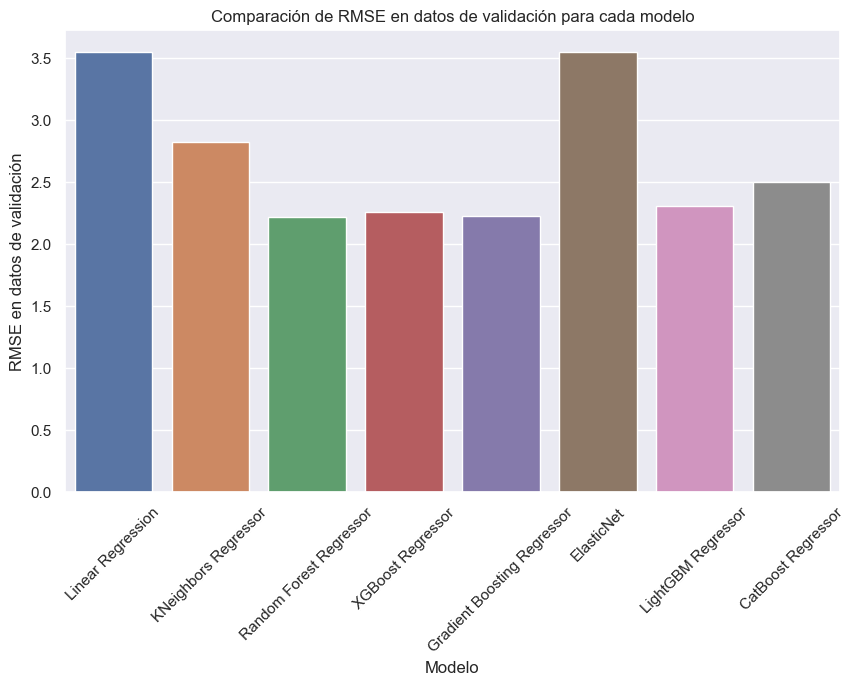

In [75]:
# Gráfico de barras para comparar el RMSE de cada modelo en el conjunto de validación
plt.figure(figsize=(10, 6))
sns.barplot(x='Modelo', y='RMSE en datos de validación', data=df)
plt.xticks(rotation=45)
plt.title("Comparación de RMSE en datos de validación para cada modelo")
plt.show()


![Descripción de la imagen](https://steemitimages.com/p/PB8ro82ZpZP77kCUDMfRNRESDLm81HhBdbKWrtMuTFqvsjZU2CB3EqMLBUaZD58tA1CY3EoxerBxz7GF7L7H1ZDjruV71encnPCcF6Khqs7bvwAW?format=match&mode=fit&width=280)

El **`RandomForestRegressor`** ha demostrado ser el mejor modelo para predecir el precio del `PACK`. 

**¿Qué nivel de precisión tiene el modelo predictivo?**

Este modelo ha logrado un `MSE` en datos de validación de aproximadamente *4.91* y un `RMSE` de aproximadamente *2.21*, lo que indica que las predicciones tienen un error promedio bajo y son más precisas en comparación con otros modelos evaluados.

Además, el `R²` en datos de validación es de aproximadamente *0.81*, lo que sugiere que este modelo puede explicar razonablemente bien la variabilidad en los precios de los packs.

También, el `MAE` en datos de validación es de aproximadamente *1.19*, lo que implica que el error absoluto promedio de las predicciones es relativamente bajo.

#### **8.5 - Evaluación del modelo:**

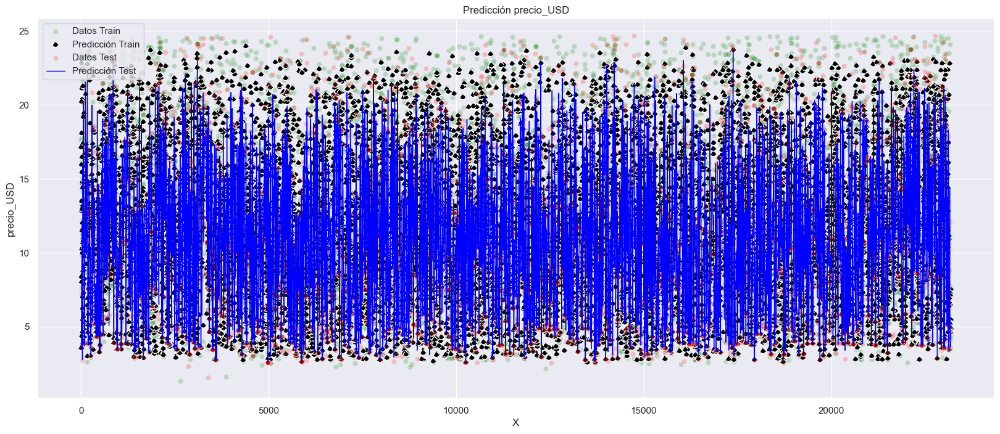

Error cuadrático medio (MSE) en datos de entrenamiento: 0.6445225796655508
Error cuadrático medio (MSE) en datos de prueba: 4.593260756402664
Raíz del error cuadrático medio (RMSE) en datos de entrenamiento: 0.8028216362714391
Raíz del error cuadrático medio (RMSE) en datos de prueba: 2.143189388832136
R-cuadrado (R²) en datos de entrenamiento: 0.9753965428774353
R-cuadrado (R²) en datos de prueba: 0.8217760818147651
Error absoluto medio (MAE) en datos de entrenamiento: 0.4201580000442357
Error absoluto medio (MAE) en datos de prueba: 1.1143196050507738


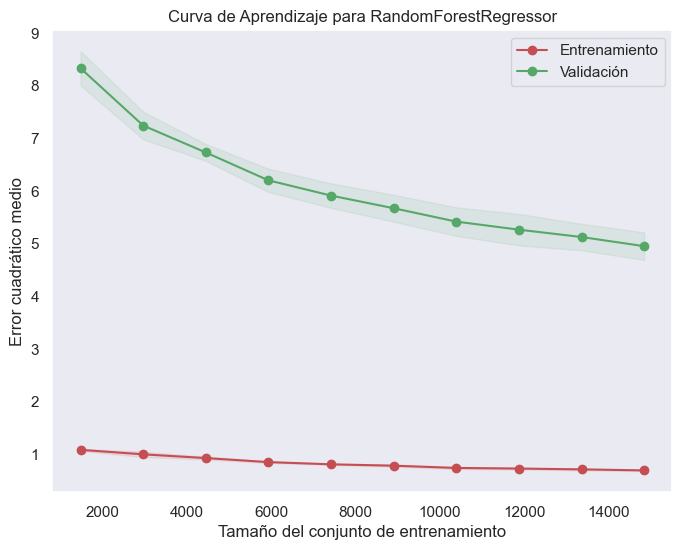

Resultados para RandomForestRegressor:
      Tamaño de entrenamiento    MSE Entrenamiento    MSE Validación
--  -------------------------  -------------------  ----------------
 0                       1484             1.08405            8.32831
 1                       2968             0.998676           7.24119
 2                       4452             0.928011           6.73001
 3                       5936             0.851117           6.20103
 4                       7420             0.809044           5.91122
 5                       8904             0.783175           5.67132
 6                      10388             0.740402           5.41703
 7                      11872             0.728628           5.26413
 8                      13356             0.713251           5.12465
 9                      14841             0.693463           4.95055
*Precio del PACK*

Modelo      Valor Real
---------   ----------
8.85        9.77      
10.64       11.08     
13.71       13.24     

In [76]:
best_model = RandomForestRegressor(n_estimators=150, max_depth=None, min_samples_leaf=1, min_samples_split=2, random_state=42)

best_model.fit(X_train_full, y_train_full)
t_train_pred = best_model.predict(X_train_full)
t_test_pred = best_model.predict(X_test)

plt.figure(figsize=(20, 8))
sns.set_theme()

sns.scatterplot(x=X_train_full.index, y=y_train_full.squeeze(), color='green', alpha=0.2, label='Datos Train')
sns.scatterplot(x=X_train_full.index, y=t_train_pred.squeeze(), color='black', linewidth=1.0, linestyle='--', label='Predicción Train')

sns.scatterplot(x=X_test.index, y=y_test.squeeze(), color='red', linewidth=1.0, alpha=0.2, label='Datos Test')
sns.lineplot(x=X_test.index, y=t_test_pred.squeeze(), color='blue', linewidth=1.0, label='Predicción Test')

plt.xlabel("X")
plt.ylabel("precio_USD")
plt.title("Predicción precio_USD")
plt.legend()

plt.show()

rf_mse_train = mean_squared_error(y_train_full, t_train_pred)
rf_mse_val = mean_squared_error(y_test, t_test_pred)

rf_rmse_train = np.sqrt(rf_mse_train)
rf_rmse_val = np.sqrt(rf_mse_val)

rf_r2_train = r2_score(y_train_full, t_train_pred)
rf_r2_val = r2_score(y_test, t_test_pred)

rf_mae_train = mean_absolute_error(y_train_full, t_train_pred)
rf_mae_val = mean_absolute_error(y_test, t_test_pred)

print('Error cuadrático medio (MSE) en datos de entrenamiento:', rf_mse_train)
print('Error cuadrático medio (MSE) en datos de prueba:', rf_mse_val)

print('Raíz del error cuadrático medio (RMSE) en datos de entrenamiento:', rf_rmse_train)
print('Raíz del error cuadrático medio (RMSE) en datos de prueba:', rf_rmse_val)

print('R-cuadrado (R²) en datos de entrenamiento:', rf_r2_train)
print('R-cuadrado (R²) en datos de prueba:', rf_r2_val)

print('Error absoluto medio (MAE) en datos de entrenamiento:', rf_mae_train)
print('Error absoluto medio (MAE) en datos de prueba:', rf_mae_val)

# Obtener la curva de aprendizaje para el modelo de RandomForestRegressor
train_sizes_rf, train_scores_rf, test_scores_rf = learning_curve(
    estimator=best_model,
    X=X_train_full,
    y=y_train_full,
    train_sizes=np.linspace(0.1, 1.0, 10),
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)

# Calcular el promedio y la desviación estándar de los puntajes de entrenamiento y prueba
train_scores_mean_rf = -np.mean(train_scores_rf, axis=1)
train_scores_std_rf = np.std(train_scores_rf, axis=1)
test_scores_mean_rf = -np.mean(test_scores_rf, axis=1)
test_scores_std_rf = np.std(test_scores_rf, axis=1)

# Crear una lista para almacenar los resultados
results_rf = []

# Agregar los resultados a la lista
for i, train_size in enumerate(train_sizes_rf):
    results_rf.append({
        'Tamaño de entrenamiento': train_size,
        'MSE Entrenamiento': train_scores_mean_rf[i],
        'MSE Validación': test_scores_mean_rf[i],
        # Agrega aquí más resultados si es necesario
    })

# Graficar la curva de aprendizaje para RandomForestRegressor
plt.figure(figsize=(8, 6))
plt.title("Curva de Aprendizaje para RandomForestRegressor")
plt.xlabel("Tamaño del conjunto de entrenamiento")
plt.ylabel("Error cuadrático medio")
plt.grid()

plt.fill_between(train_sizes_rf, train_scores_mean_rf - train_scores_std_rf,
                 train_scores_mean_rf + train_scores_std_rf, alpha=0.1,
                 color="r")
plt.fill_between(train_sizes_rf, test_scores_mean_rf - test_scores_std_rf,
                 test_scores_mean_rf + test_scores_std_rf, alpha=0.1, color="g")
plt.plot(train_sizes_rf, train_scores_mean_rf, 'o-', color="r",
         label="Entrenamiento")
plt.plot(train_sizes_rf, test_scores_mean_rf, 'o-', color="g",
         label="Validación")

plt.legend(loc="best")

# Mostrar la gráfica de la curva de aprendizaje
plt.show()

# Crear un DataFrame con los resultados
df_results_rf = pd.DataFrame(results_rf)

# Imprimir la tabla de resultados
print("Resultados para RandomForestRegressor:")
print(tabulate(df_results_rf, headers='keys'))

# Imprimir algunos ejemplos de predicciones y valores reales en el conjunto de prueba
print('*Precio del PACK*\n')
print(f'Modelo      Valor Real')
print(f'---------   ----------')
for i in range(10):
    print(f'{t_test_pred[i]:<10.2f}  {y_test.iloc[i]:<10.2f}')
print('etc...')



In [77]:
# Datos de entrada para hacer una predicción
nueva_muestra = {
    'alto': 20,
    'largo': 120,
    'ancho': 100,
    'peso': 80,
    'bultos': 10,
    'provincia_origen': 'BUENOS AIRES',
    'cp_origen': 1437,
    'provincia_destino': 'CORDOBA',
    'cp_destino': 9400,
    'volumen_total': 0,
    'relacion_peso_volumen': 0,
    'costo_promedio_bulto': 0
}

# Crear una copia de la nueva muestra para no modificar la original
nueva_muestra_encoded = nueva_muestra.copy()

# Codificación de las variables categóricas con LabelEncoder
categorical_columns = ['provincia_origen', 'provincia_destino']
label_encodings = {}

for column in categorical_columns:
    le = LabelEncoder()
    nueva_muestra_encoded[column] = le.fit_transform([nueva_muestra_encoded[column]])[0]
    label_encodings[column] = le

# Convertir los datos de entrada en un DataFrame
nueva_muestra_df = pd.DataFrame([nueva_muestra_encoded])

# Realizar Encoding para las variables categóricas
nueva_muestra_df_encoded = pd.get_dummies(nueva_muestra_df, columns=['provincia_origen', 'provincia_destino'])

# Asegurarse de que todas las columnas requeridas estén presentes
# Si faltan columnas, agregarlas con valor 0 para la nueva muestra
columnas_entrenamiento = set(X_train_full.columns)
columnas_nueva_muestra = set(nueva_muestra_df_encoded.columns)

columnas_faltantes = columnas_entrenamiento - columnas_nueva_muestra
for col in columnas_faltantes:
    nueva_muestra_df_encoded[col] = 0

# Asegurarse de que el orden de las columnas sea el mismo que en el conjunto de entrenamiento
nueva_muestra_df_encoded = nueva_muestra_df_encoded[X_train_full.columns]

# Realizar la predicción con el modelo entrenado
precio_predicho = best_model.predict(nueva_muestra_df_encoded)

# Resultado de la predicción
print(f"El precio predicho para la muestra proporcionada es: {precio_predicho[0]:.2f} USD")

El precio predicho para la muestra proporcionada es: 10.02 USD


## ⏩ **9. <u>Conclusiones</u>** 

El proyecto ha sido un éxito al desarrollar un modelo de regresión (**`RandomForestRegressor`**) altamente preciso para predecir los precios de los servicios ofrecidos. Las sólidas métricas de evaluación (`MSE`, `MAE` y `R²`) respaldan la capacidad del modelo para ajustarse bien a los datos y realizar predicciones cercanas a los valores reales.

**¿Qué ventajas tiene predecir el precio de los servicios para la gestión del negocio?**
Este modelo sera una herramienta valiosa para la gestión del negocio, ya que permite tomar decisiones informadas y estratégicas sobre la fijación de precios de los servicios. Al identificar las características más influyentes, el modelo puede proporcionar información relevante para optimizar los precios y maximizar los beneficios.

Sin embargo es importante destacar que la precisión y el rendimiento del modelo deben seguir siendo monitoreados y actualizados periódicamente con nuevos datos. Esto asegurará que el modelo continúe siendo confiable y relevante a medida que cambien las condiciones del mercado y los factores que afectan los precios de los servicios.